# Problem Statement
What are the key characteristics of tennis players who win, especially in very close matches that last for up five sets? 
Also, is it possible to create a model that is better at predicting the winner than simply using the official ATP ranking?

In [1]:
import pandas as pd
import re
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.dummy import DummyClassifier
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import recall_score
from time import process_time
import time

In [2]:
# Load the ATP match data from Kaggle (https://www.kaggle.com/datasets/sijovm/atpdata/data)
df=pd.read_csv(r'C:\Users\fc_pe\OneDrive\Documents\Professional Development\Berkeley Professional Certificate in ML and AI\Capstone Project\atp_matches_till_2022.csv')

In [3]:
df_slice=df.iloc[0:18,20:30]
df_slice.head()

,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt
0,NaN,UNK,24.0,6-1 7-5,3,R32,NaN,NaN,NaN,NaN
1,NaN,IRL,NaN,6-1 6-1,3,R32,NaN,NaN,NaN,NaN
2,NaN,IRL,NaN,6-2 6-2,3,R32,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,6-1 6-1,3,R32,NaN,NaN,NaN,NaN
4,NaN,IRL,NaN,6-2 6-4,3,R32,NaN,NaN,NaN,NaN


In [232]:
df.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
0,1968-2029,Dublin,Grass,32,A,19680708,270,112411,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1968-2029,Dublin,Grass,32,A,19680708,271,126914,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1968-2029,Dublin,Grass,32,A,19680708,272,209523,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1968-2029,Dublin,Grass,32,A,19680708,273,100084,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1968-2029,Dublin,Grass,32,A,19680708,274,100132,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
df['score']

0                 6-1 7-5
1                 6-1 6-1
2                 6-2 6-2
3                 6-1 6-1
4                 6-2 6-4
               ...       
188156            6-4 6-4
188157        4-6 6-4 6-4
188158    1-6 6-4 4-1 RET
188159            6-4 6-4
188160            6-4 6-4
Name: score, Length: 188161, dtype: object

In [6]:
# Check distribution of right and left handed players
df['winner_hand'].value_counts()

winner_hand
R    158958
L     27205
U      1981
Name: count, dtype: int64

In [7]:
# Consider encoding R=1, L=-1, and U=0
df['loser_hand'].value_counts()

loser_hand
R    157351
L     24847
U      5899
Name: count, dtype: int64

In [8]:
df['surface'].value_counts()

surface
Hard      74810
Clay      67428
Grass     22841
Carpet    20765
Name: count, dtype: int64

In [9]:
#string="This is (a parenthetical) remark" 
 
#x=re.sub("\(.*\)","",string) 

#print(x)

#function remove_remove_tiebreaker_score(x):
 #   new_x=x
  #  length=len(x)
   # s=-1
    #e=-1
    #for i in length:
    #    if x[i]='(':
    #        s=i
    #    if x[i]=')':
     #       e=i
     #       new_x=
    
    
        
    

In [10]:
#s='7-2(5) 7-6(4) 6-1'
#s1=re.sub("\(.*\)","",s)
#print(s1)

In [11]:
#s='7-2(5) 7-6(4) 6-1 6-7(9) 7-5'
#s1=re.sub("\(.*\)","",s)
#print(s1)

In [12]:
#a_string = "(3)abc(def)de(f)"

#modified_string = re.sub(r"\([^()]*\)", "", a_string)

#print(modified_string)

In [13]:
#a_string = "6-2(5) 7-6(3) 7-6(1)"

#modified_string = re.sub(r"\([^()]*\)", "", a_string)

#print(modified_string)

In [14]:
#def remove_tiebreaker_score(x):
   
#    new_x=re.sub(r"\([^()]*\)", "", x.to_string())
#    return new_x

#print(remove_tiebreaker_score('6-2(4) 7-6(12)'))

In [15]:
#x='6-2 7-6(3)'
#new_x=re.sub(r"\([^()]*\)", "",x)
#print(new_x)

In [16]:
#X=df_slice['score']
#print(remove_tiebreaker_score(X))

In [17]:
# Create function that counts number of sets in a score
def count_sets(x):
#    x1=x.to_string() # new line of code
    length=len(x)
    sets=0
    for i in range(0,length):
        if x[i]=='-':
            sets=sets+1
    return sets
    


In [18]:
# Calculate number of sets in a score
n_sets=count_sets('6-7(5) 7-6(5) 7-6(4) 3-6 7-5')
print(n_sets)

5


In [19]:
# Create functions that counts number of sets for winner and loser
def w_sets(n_sets,best_of):
    w_sets=n_sets
    if ((n_sets==2) & (best_of==3)):
        w_sets=2
    if ((n_sets==3) & (best_of==3)):
        w_sets=2
    if ((n_sets==3) & (best_of==5)):
        w_sets=3
    if ((n_sets==4) & (best_of==5)):
        w_sets=3
    if ((n_sets==5) & (best_of==5)):
        w_sets=3
    return w_sets

def l_sets(n_sets,best_of):
    l_sets=0
    if ((n_sets==2) & (best_of==3)):
        l_sets=0
    if ((n_sets==3) & (best_of==3)):
        l_sets=1
    if ((n_sets==3) & (best_of==5)):
        l_sets=0
    if ((n_sets==4) & (best_of==5)):
        l_sets=1
    if ((n_sets==5) & (best_of==5)):
        l_sets=2
    return l_sets

In [20]:
print(w_sets(3,5))

3


In [21]:
print(l_sets(2,3))

0


In [22]:
# Check how Python handles names based on alphabetical order - will be used later for Player A and Player B
if ('Rafael Nadal'>'Novak Djokovic'):
    print('Player B is:','Rafael Nadal')

Player B is: Rafael Nadal


In [23]:
# Create dataframe df1 containing matches from January 1, 2010 - limit the study to matches played in relatively modern time
df1=df[df['tourney_date']>=20100000]


In [24]:
df1.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
151652,2010-339,Brisbane,Hard,32,A,20100103,1,104053,1.0,NaN,...,34.0,29.0,11.0,10.0,3.0,5.0,7.0,4410.0,77.0,598.0
151653,2010-339,Brisbane,Hard,32,A,20100103,2,104958,NaN,WC,...,34.0,22.0,14.0,9.0,7.0,10.0,134.0,400.0,78.0,590.0
151654,2010-339,Brisbane,Hard,32,A,20100103,3,104755,NaN,NaN,...,58.0,38.0,14.0,14.0,7.0,11.0,52.0,850.0,88.0,568.0
151655,2010-339,Brisbane,Hard,32,A,20100103,4,105051,NaN,Q,...,29.0,16.0,15.0,9.0,2.0,5.0,285.0,151.0,28.0,1260.0
151656,2010-339,Brisbane,Hard,32,A,20100103,5,104607,4.0,NaN,...,41.0,26.0,14.0,9.0,6.0,9.0,20.0,1655.0,251.0,179.0


In [25]:
# Check distribution of different surfaces
df1['surface'].value_counts()

surface
Hard      21320
Clay      11261
Grass      3862
Carpet       66
Name: count, dtype: int64

In [26]:
df1['tourney_level'].value_counts()

tourney_level
A    19696
M     6858
G     6477
D     3236
F      242
Name: count, dtype: int64

In [27]:
# Remove matches played on carpet (surface type removed from 2009)
df2=df1[df1['surface']!='Carpet']

In [28]:
df2['surface'].value_counts()

surface
Hard     21320
Clay     11261
Grass     3862
Name: count, dtype: int64

In [29]:
# Encode 'surface' as Grass=1, Hard=0, and Clay=-1 (the higher the number, the faster the surface)
df3=df2.replace(to_replace=['Grass','Hard','Clay'],value=[1,0,-1])

In [30]:
df3['surface'].value_counts()

surface
 0    21320
-1    11261
 1     3862
Name: count, dtype: int64

In [31]:
# Add new columns 'Player A' and 'Player B' where Player A's name comes before Player B's name in alphabetical order
df3['Player A']=df3[['winner_name','loser_name']].min(axis=1)
df3['Player B']=df3[['winner_name','loser_name']].max(axis=1)

In [32]:
df3.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B
151652,2010-339,Brisbane,0,32,A,20100103,1,104053,1.0,NaN,...,11.0,10.0,3.0,5.0,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak
151653,2010-339,Brisbane,0,32,A,20100103,2,104958,NaN,WC,...,14.0,9.0,7.0,10.0,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev
151654,2010-339,Brisbane,0,32,A,20100103,3,104755,NaN,NaN,...,14.0,14.0,7.0,11.0,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet
151655,2010-339,Brisbane,0,32,A,20100103,4,105051,NaN,Q,...,15.0,9.0,2.0,5.0,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden
151656,2010-339,Brisbane,0,32,A,20100103,5,104607,4.0,NaN,...,14.0,9.0,6.0,9.0,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych


In [33]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
Index: 36443 entries, 151652 to 188160
Data columns (total 51 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   tourney_id          36443 non-null  object 
 1   tourney_name        36443 non-null  object 
 2   surface             36443 non-null  int64  
 3   draw_size           36443 non-null  int64  
 4   tourney_level       36443 non-null  object 
 5   tourney_date        36443 non-null  int64  
 6   match_num           36443 non-null  int64  
 7   winner_id           36443 non-null  int64  
 8   winner_seed         15622 non-null  float64
 9   winner_entry        4718 non-null   object 
 10  winner_name         36443 non-null  object 
 11  winner_hand         36432 non-null  object 
 12  winner_ht           35887 non-null  float64
 13  winner_ioc          36443 non-null  object 
 14  winner_age          36440 non-null  float64
 15  loser_id            36443 non-null  int64  
 16  los

In [34]:
# Check distribution of tournament rounds
df3['round'].value_counts()

round
R32     11272
R16      6456
R64      5301
R128     4032
RR       3642
QF       3236
SF       1662
F         837
BR          5
Name: count, dtype: int64

In [35]:
df3.shape

(36443, 51)

In [36]:
# Remove matches played in Round Robin (RR) and BR formats
df4=df3[(df3['round']!='RR') & (df3['round']!='BR')]

In [37]:
df4['round'].value_counts()

round
R32     11272
R16      6456
R64      5301
R128     4032
QF       3236
SF       1662
F         837
Name: count, dtype: int64

In [38]:
df4.shape

(32796, 51)

In [39]:
# Replace categories in 'round' with values R128=0, R64=1, R32=2, R16=3, QF=4, SF=5, F=6
df5=df4.copy()
df5['round'].replace(to_replace=['R128','R64','R32','R16','QF','SF','F'],value=[0,1,2,3,4,5,6],inplace=True)

In [40]:
df5['round'].value_counts()

round
2    11272
3     6456
1     5301
0     4032
4     3236
5     1662
6      837
Name: count, dtype: int64

In [41]:
df5.iloc[:,25:45]

,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
151652,2,84.0,15.0,0.0,63.0,42.0,36.0,14.0,10.0,3.0,3.0,4.0,2.0,56.0,34.0,29.0,11.0,10.0,3.0,5.0
151653,2,70.0,10.0,3.0,57.0,30.0,23.0,19.0,10.0,0.0,0.0,2.0,2.0,66.0,34.0,22.0,14.0,9.0,7.0,10.0
151654,2,121.0,5.0,4.0,97.0,51.0,33.0,27.0,15.0,5.0,8.0,4.0,0.0,85.0,58.0,38.0,14.0,14.0,7.0,11.0
151655,2,64.0,12.0,1.0,50.0,35.0,30.0,12.0,10.0,3.0,3.0,2.0,1.0,53.0,29.0,16.0,15.0,9.0,2.0,5.0
151656,2,69.0,3.0,1.0,46.0,27.0,24.0,14.0,9.0,1.0,1.0,6.0,1.0,69.0,41.0,26.0,14.0,9.0,6.0,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187924,5,99.0,10.0,0.0,66.0,50.0,42.0,8.0,11.0,1.0,2.0,15.0,5.0,88.0,66.0,45.0,9.0,12.0,5.0,6.0
187925,5,82.0,4.0,1.0,69.0,47.0,36.0,14.0,12.0,1.0,2.0,2.0,0.0,62.0,40.0,30.0,10.0,10.0,2.0,4.0
187938,6,92.0,9.0,0.0,55.0,39.0,33.0,11.0,11.0,0.0,0.0,6.0,1.0,57.0,40.0,31.0,6.0,10.0,3.0,5.0
187939,5,68.0,10.0,0.0,46.0,35.0,27.0,8.0,9.0,0.0,1.0,9.0,0.0,50.0,30.0,20.0,9.0,9.0,0.0,4.0


In [42]:
# Check matches played by player ID 104745 - Rafael Nadal
print(df5[df5['loser_id']==104745])

       tourney_id          tourney_name  surface  draw_size tourney_level  \
151744   2010-451                  Doha        0         32             A   
151922   2010-580       Australian Open        0        128             G   
152523   2010-404  Indian Wells Masters        0         96             M   
152618   2010-403         Miami Masters        0         96             M   
153258   2010-311          Queen's Club        1         56             A   
...           ...                   ...      ...        ...           ...   
186391  2022-0416          Rome Masters       -1         64             M   
186913   2022-540             Wimbledon        1        128             G   
187267  2022-0422    Cincinnati Masters        0         64             M   
187458   2022-560               Us Open        0        128             G   
187898  2022-0352         Paris Masters        0         64             M   

        tourney_date  match_num  winner_id  winner_seed winner_entry  ...  

In [43]:
df5['tourney_level'].value_counts()

tourney_level
A    19413
M     6858
G     6477
F       48
Name: count, dtype: int64

In [44]:
# Replace 'tourney_level' categories with F=0, A=1, M=2, and G=3
d6=df5.copy()
d6['tourney_level'].replace(to_replace=['F','A','M','G'],value=[0,1,2,3],inplace=True)

In [45]:
d6['tourney_level'].value_counts()

tourney_level
1    19413
2     6858
3     6477
0       48
Name: count, dtype: int64

In [46]:
# Subtract 20,000,000 to convert from YYYYMMDD format to YYMMDD format and then take the logarithm to reduce number size
d6['log tourney_date']=np.log10(d6['tourney_date']-20000000)

In [47]:
d6.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,10.0,3.0,5.0,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,9.0,7.0,10.0,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,14.0,7.0,11.0,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,9.0,2.0,5.0,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,9.0,6.0,9.0,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447


In [48]:
d6['winner_hand'].value_counts()

winner_hand
R    28310
L     4448
U       38
Name: count, dtype: int64

In [49]:
d6['loser_hand'].value_counts()

loser_hand
R    27931
L     4725
U      140
Name: count, dtype: int64

In [50]:
# Encode 'winner_hand' and 'loser_hand' categories as R=1, U=0, and L=-1
d7=d6.copy()
d7['winner_hand'].replace(to_replace=['R','U','L'],value=[1,0,-1],inplace=True)
d7['loser_hand'].replace(to_replace=['R','U','L'],value=[1,0,-1],inplace=True)

In [51]:
d7['winner_hand'].value_counts()

winner_hand
 1    28310
-1     4448
 0       38
Name: count, dtype: int64

In [52]:
d7['loser_hand'].value_counts()

loser_hand
 1    27931
-1     4725
 0      140
Name: count, dtype: int64

In [53]:
d7.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,10.0,3.0,5.0,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,9.0,7.0,10.0,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,14.0,7.0,11.0,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,9.0,2.0,5.0,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,9.0,6.0,9.0,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447


In [54]:
# Create 'Player A ID' and 'Player B ID' features that correspond to the 'Player A' and 'Player B' features.
# Player A and Player B are in alphabetical order and will be used together with a target feature "winner"
# that will be created below for the training of the different models as the original dataset lacks a target feature.
d7['Player A ID']=np.where(d7['Player A']==d7['winner_name'],d7['winner_id'],d7['loser_id'])
d7['Player B ID']=np.where(d7['Player B']==d7['winner_name'],d7['winner_id'],d7['loser_id'])

In [55]:
d7.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,5.0,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,10.0,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,11.0,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,5.0,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,9.0,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607


In [56]:
# Create target feature 'winner', which is either 'A' or 'B', corresponding to Player A and Player B, respectively
d7['winner']=np.where(d7['Player A']==d7['winner_name'],'A','B')

In [57]:
d7.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B


In [58]:
d7.iloc[:,22:55]

,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,...,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner
151652,30.3,7-6(5) 6-2,3,2,84.0,15.0,0.0,63.0,42.0,36.0,...,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A
151653,22.3,7-5 6-1,3,2,70.0,10.0,3.0,57.0,30.0,23.0,...,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A
151654,28.4,6-3 4-6 6-4,3,2,121.0,5.0,4.0,97.0,51.0,33.0,...,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B
151655,28.6,7-5 6-1,3,2,64.0,12.0,1.0,50.0,35.0,30.0,...,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B
151656,21.4,6-2 6-4,3,2,69.0,3.0,1.0,46.0,27.0,24.0,...,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187924,20.8,4-3(6) 1-4 4-2 4-3(5),5,5,99.0,10.0,0.0,66.0,50.0,42.0,...,49.0,927.0,41.0,1020.0,Brandon Nakashima,Jack Draper,5.344602,206909,207733,A
187925,20.2,4-1 4-3(4) 2-4 4-1,5,5,82.0,4.0,1.0,69.0,47.0,36.0,...,74.0,715.0,111.0,497.0,Dominic Stricker,Jiri Lehecka,5.344602,208502,208103,B
187938,23.8,7-5 6-3,3,6,92.0,9.0,0.0,55.0,39.0,33.0,...,8.0,3320.0,4.0,5020.0,Casper Ruud,Novak Djokovic,5.344616,134770,104925,B
187939,25.0,6-2 6-4,3,5,68.0,10.0,0.0,46.0,35.0,27.0,...,4.0,5020.0,7.0,3530.0,Andrey Rublev,Casper Ruud,5.344616,126094,134770,B


In [59]:
# Create new column containing number of sets: 'n_sets'
d7['n_sets']=d7['score'].apply(count_sets)

In [60]:
d7['n_sets']

151652    2
151653    2
151654    3
151655    2
151656    2
         ..
187924    4
187925    4
187938    2
187939    2
187940    2
Name: n_sets, Length: 32796, dtype: int64

In [61]:
d7.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A,2
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A,2
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B,3
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B,2
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B,2


In [62]:
d7.shape

(32796, 56)

In [63]:
# Create function that checks the last three characters of 'score' for 'RET' (meaning a player retired)
def score_ends_with_RET(x):
    return x[-3:]=='RET'

#print(score_ends_with_RET('4-6 6-4 7-6(1) RET'))

# Remove all matches where a player retired
d8=d7[d7['score'].apply(score_ends_with_RET)==False]

In [64]:
d8.shape

(31804, 56)

In [65]:
# Remove rows where 'score'=='W/O' - Walkover
d9=d8[d8['score']!='W/O']

In [66]:
d9.shape

(31652, 56)

In [67]:
d9.shape[0]

31652

In [68]:
# Create two new columns with number of sets that the winner and the loser won: 'w_sets' and 'l_sets'
# w_sets and l_sets were intended to be used in an earlier version for a feature '121idx' that was later discarded as it was found to not be effective
d9['w_sets']=d9.apply(lambda x: w_sets(x['n_sets'],x['best_of']),axis=1)
d9['l_sets']=d9.apply(lambda x: l_sets(x['n_sets'],x['best_of']),axis=1)

C:\Users\fc_pe\AppData\Local\Temp\ipykernel_22988\1012529198.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d9['w_sets']=d9.apply(lambda x: w_sets(x['n_sets'],x['best_of']),axis=1)
C:\Users\fc_pe\AppData\Local\Temp\ipykernel_22988\1012529198.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d9['l_sets']=d9.apply(lambda x: l_sets(x['n_sets'],x['best_of']),axis=1)


In [69]:
d9.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A,2,2,0
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A,2,2,0
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B,3,2,1
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B,2,2,0
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B,2,2,0


In [70]:
# Create function decimal_year that converts date in YYYYMMDD format to a year with a decimal based on month of the year
def decimal_year(date):
    date=date/10000
    year,decimal=divmod(date,1)
    month=round(decimal*100)
    return year+month/12
    
# Test decimal_year function
print(decimal_year(20210930))

2021.75


In [71]:
d9.shape[0]

31652

In [72]:
## Feature '121idx' below was not found to be effective and later discarded:

# Create function '1-2-1_IDX' that calculates an index based on previous matches between players A and B
# taking into account how close the previous matches were in terms of sets and applying weights based
# on how long time ago the matches took place using exponential decrease e(-t/3) with t in years
# Example: A beat B by 3-1 in sets one year ago: Index=(3-1)/3*exp(-1/3)=0.48
# Also, B beat A by 3-2 in sets two years ago: Index=-(3-2)/3*exp(-2/3)=-0.17
# Finally, add all weighted match results together: 121_IDX=0.48-0.17=0.31>0
# So, the index suggests that player A is favoured over player B based on previous matches
# If the index is negative, then player B is favoured over player A

#d9['121idx']=np.nan
#d9['121idx'].iloc[0]=0
#for i in range(1,d9.shape[0]):
#for i in range(1,1000):
#    index=0
#    for j in range(0,i-1):
#        temp_index=0
#        if ((d9['Player A ID'].iloc[i]==d9['Player A ID'].iloc[j])&(d9['Player B ID'].iloc[i]==d9['Player B ID'].iloc[j])):
#            temp_index=(d9['w_sets'].iloc[j]-d9['l_sets'].iloc[j])/d9['w_sets'].iloc[j]*np.exp((decimal_year(d9['tourney_date'].iloc[j])-decimal_year(d9['tourney_date'].iloc[i]))/3)
#            if (d9['winner'].iloc[j]=='B'):
#                temp_index=-temp_index
#        index=index+temp_index
#    d9['121idx'].iloc[i]=index


##d9['121idx']=np.nan
##d9['121idx'].iloc[0]=0
#for i in range(1,d9.shape[0]):
##for i in range(1,5000):
##    index=0
##    if ((d9['winner_rank'].iloc[i]<100)&(d9['loser_rank'].iloc[i]<100)):
        
#for i in range(1,1000):

#        index=0
##        for j in range(0,i-1):
##            temp_index=0
##            if (d9['Player A ID'].iloc[i]==d9['Player A ID'].iloc[j]):
##                if (d9['Player B ID'].iloc[i]==d9['Player B ID'].iloc[j]):
##                    temp_index=(d9['w_sets'].iloc[j]-d9['l_sets'].iloc[j])/d9['w_sets'].iloc[j]*np.exp((decimal_year(d9['tourney_date'].iloc[j])-decimal_year(d9['tourney_date'].iloc[i]))/3)
##                    if (d9['winner'].iloc[j]=='B'):
##                        temp_index=-temp_index
##                    index=index+temp_index
##    d9['121idx'].iloc[i]=index    
    
##Adding an empty column named Active to the existing dataframe
#df['answer'] = np.nan

####putting the first value as 1
#df['answer'].loc[0] = 1 

#df

#for index in range(1,df.shape[0]):  
#    if ( (df['SERIAL_NUMBER'].iloc[index] !=  df['SERIAL_NUMBER'].iloc[index-1]) | 
#        (df['OPERATION'].iloc[index] != '000') & (df['OPERATION'].iloc[index-1] == '000') ):
#        df['answer'].iloc[index]=df['answer'].iloc[index-1]+1
#    else:
#        df['answer'].iloc[index]=df['answer'].iloc[index-1]
#print(df)

In [73]:
##d9['121idx'].iloc[4800:4850]

In [74]:
d99=d9.iloc[0:1000]

In [75]:
d99.shape

(1000, 58)

In [76]:
d99.tail()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
152831,2010-416,Rome Masters,-1,56,2,20100425,48,104925,2.0,NaN,...,1402.0,Novak Djokovic,Thomaz Bellucci,5.001842,104925,105064,A,2,2,0
152832,2010-416,Rome Masters,-1,56,2,20100425,49,105208,NaN,NaN,...,1205.0,Ernests Gulbis,Feliciano Lopez,5.001842,105208,103852,A,2,2,0
152833,2010-416,Rome Masters,-1,56,2,20100425,50,104745,3.0,NaN,...,1510.0,Rafael Nadal,Stan Wawrinka,5.001842,104745,104527,A,2,2,0
152834,2010-416,Rome Masters,-1,56,2,20100425,51,103970,13.0,NaN,...,3050.0,David Ferrer,Jo-Wilfried Tsonga,5.001842,103970,104542,A,2,2,0
152835,2010-416,Rome Masters,-1,56,2,20100425,52,104269,6.0,NaN,...,7390.0,Fernando Verdasco,Novak Djokovic,5.001842,104269,104925,A,3,2,1


In [77]:
# Only include matches with top 25 players:
## d10=d9[((d9['winner_rank']<25)&(d9['loser_rank']<25))]

# Include ALL matches starting from 2010
d10=d9.copy()

In [78]:
d10.tail()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
187924,2022-7696,NextGen Finals,0,8,1,20221107,299,206909,4.0,NaN,...,1020.0,Brandon Nakashima,Jack Draper,5.344602,206909,207733,A,4,3,1
187925,2022-7696,NextGen Finals,0,8,1,20221107,298,208103,5.0,NaN,...,497.0,Dominic Stricker,Jiri Lehecka,5.344602,208502,208103,B,4,3,1
187938,2022-0605,Tour Finals,0,8,0,20221114,300,104925,7.0,NaN,...,5020.0,Casper Ruud,Novak Djokovic,5.344616,134770,104925,B,2,2,0
187939,2022-0605,Tour Finals,0,8,0,20221114,299,134770,3.0,NaN,...,3530.0,Andrey Rublev,Casper Ruud,5.344616,126094,134770,B,2,2,0
187940,2022-0605,Tour Finals,0,8,0,20221114,298,104925,7.0,NaN,...,2955.0,Novak Djokovic,Taylor Fritz,5.344616,104925,126203,A,2,2,0


In [79]:
d10.shape

(31652, 58)

In [80]:
## Below feature '121idx' was discarded

##d10['121idx']=np.nan
##d10['121idx'].iloc[0]=0
##for i in range(1,d10.shape[0]):
#for i in range(1,5000):
##    index=0
#    if ((d9['winner_rank'].iloc[i]<100)&(d9['loser_rank'].iloc[i]<100)):
        
#for i in range(1,1000):

#        index=0
##    for j in range(0,i-1):
##        temp_index=0
##        if (d10['Player A ID'].iloc[i]==d10['Player A ID'].iloc[j]):
##            if (d10['Player B ID'].iloc[i]==d10['Player B ID'].iloc[j]):
##                temp_index=(d10['w_sets'].iloc[j]-d10['l_sets'].iloc[j])/d10['w_sets'].iloc[j]*np.exp((decimal_year(d10['tourney_date'].iloc[j])-decimal_year(d10['tourney_date'].iloc[i]))/3)
##                if (d10['winner'].iloc[j]=='B'):
##                    temp_index=-temp_index
##                index=index+temp_index
##   d10['121idx'].iloc[i]=index 

In [81]:
##d10['121idx'].iloc[2200:2250]

In [82]:
d10.tail()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
187924,2022-7696,NextGen Finals,0,8,1,20221107,299,206909,4.0,NaN,...,1020.0,Brandon Nakashima,Jack Draper,5.344602,206909,207733,A,4,3,1
187925,2022-7696,NextGen Finals,0,8,1,20221107,298,208103,5.0,NaN,...,497.0,Dominic Stricker,Jiri Lehecka,5.344602,208502,208103,B,4,3,1
187938,2022-0605,Tour Finals,0,8,0,20221114,300,104925,7.0,NaN,...,5020.0,Casper Ruud,Novak Djokovic,5.344616,134770,104925,B,2,2,0
187939,2022-0605,Tour Finals,0,8,0,20221114,299,134770,3.0,NaN,...,3530.0,Andrey Rublev,Casper Ruud,5.344616,126094,134770,B,2,2,0
187940,2022-0605,Tour Finals,0,8,0,20221114,298,104925,7.0,NaN,...,2955.0,Novak Djokovic,Taylor Fritz,5.344616,104925,126203,A,2,2,0


In [83]:
d10.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31652 entries, 151652 to 187940
Data columns (total 58 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   tourney_id          31652 non-null  object 
 1   tourney_name        31652 non-null  object 
 2   surface             31652 non-null  int64  
 3   draw_size           31652 non-null  int64  
 4   tourney_level       31652 non-null  int64  
 5   tourney_date        31652 non-null  int64  
 6   match_num           31652 non-null  int64  
 7   winner_id           31652 non-null  int64  
 8   winner_seed         14974 non-null  float64
 9   winner_entry        4526 non-null   object 
 10  winner_name         31652 non-null  object 
 11  winner_hand         31652 non-null  int64  
 12  winner_ht           31607 non-null  float64
 13  winner_ioc          31652 non-null  object 
 14  winner_age          31652 non-null  float64
 15  loser_id            31652 non-null  int64  
 16  los

In [84]:
d10.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A,2,2,0
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A,2,2,0
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B,3,2,1
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B,2,2,0
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B,2,2,0


In [85]:
##d11=d10.drop(['tourney_id','tourney_name','draw_size','tourney_date','match_num','winner_id','winner_seed','winner_entry','winner_name','winner_ioc','loser_id','loser_seed','loser_entry','loser_name','loser_ioc','score','winner_rank','loser_rank','Player A','Player B','n_sets','w_sets','l_sets'],axis=1)
# Include feature n_sets:
d11=d10.drop(['tourney_id','tourney_name','draw_size','tourney_date','match_num','winner_id','winner_seed','winner_entry','winner_name','winner_ioc','loser_id','loser_seed','loser_entry','loser_name','loser_ioc','score','winner_rank','loser_rank','Player A','Player B','w_sets','l_sets'],axis=1)


In [86]:
d11.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,winner,n_sets
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,...,10.0,3.0,5.0,4410.0,598.0,5.000447,104053,103429,A,2
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,...,9.0,7.0,10.0,400.0,590.0,5.000447,104958,104999,A,2
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,...,14.0,7.0,11.0,850.0,568.0,5.000447,103813,104755,B,3
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,...,9.0,2.0,5.0,151.0,1260.0,5.000447,103781,105051,B,2
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,...,9.0,6.0,9.0,1655.0,179.0,5.000447,105194,104607,B,2


In [87]:
d11.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31652 entries, 151652 to 187940
Data columns (total 36 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   surface             31652 non-null  int64  
 1   tourney_level       31652 non-null  int64  
 2   winner_hand         31652 non-null  int64  
 3   winner_ht           31607 non-null  float64
 4   winner_age          31652 non-null  float64
 5   loser_hand          31652 non-null  int64  
 6   loser_ht            31457 non-null  float64
 7   loser_age           31651 non-null  float64
 8   best_of             31652 non-null  int64  
 9   round               31652 non-null  int64  
 10  minutes             30168 non-null  float64
 11  w_ace               31521 non-null  float64
 12  w_df                31521 non-null  float64
 13  w_svpt              31521 non-null  float64
 14  w_1stIn             31521 non-null  float64
 15  w_1stWon            31521 non-null  float64
 16  w_2

In [88]:
d12=d11.dropna()

In [89]:
d12.shape

(29868, 36)

In [90]:
d12.info()

<class 'pandas.core.frame.DataFrame'>
Index: 29868 entries, 151652 to 187940
Data columns (total 36 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   surface             29868 non-null  int64  
 1   tourney_level       29868 non-null  int64  
 2   winner_hand         29868 non-null  int64  
 3   winner_ht           29868 non-null  float64
 4   winner_age          29868 non-null  float64
 5   loser_hand          29868 non-null  int64  
 6   loser_ht            29868 non-null  float64
 7   loser_age           29868 non-null  float64
 8   best_of             29868 non-null  int64  
 9   round               29868 non-null  int64  
 10  minutes             29868 non-null  float64
 11  w_ace               29868 non-null  float64
 12  w_df                29868 non-null  float64
 13  w_svpt              29868 non-null  float64
 14  w_1stIn             29868 non-null  float64
 15  w_1stWon            29868 non-null  float64
 16  w_2

In [91]:
# Replace 'winner' categories with A=1, B=0
d13=d12.copy()
d13['winner'].replace(to_replace=['A','B'],value=[1,0],inplace=True)

In [92]:
d13['winner'].value_counts()

winner
0    15052
1    14816
Name: count, dtype: int64

In [93]:
# d13 is the final dataset that models will be based on and includes the target feature 'winner'
d13.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,winner,n_sets
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,...,10.0,3.0,5.0,4410.0,598.0,5.000447,104053,103429,1,2
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,...,9.0,7.0,10.0,400.0,590.0,5.000447,104958,104999,1,2
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,...,14.0,7.0,11.0,850.0,568.0,5.000447,103813,104755,0,3
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,...,9.0,2.0,5.0,151.0,1260.0,5.000447,103781,105051,0,2
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,...,9.0,6.0,9.0,1655.0,179.0,5.000447,105194,104607,0,2


In [94]:
# Calculate correlation matrix to see which features have the highest correlation with target feature 'winner'
corr_matrix=d13.corr()
print(corr_matrix)

                     surface  tourney_level  winner_hand  winner_ht  \
surface             1.000000       0.098741     0.047836   0.090447   
tourney_level       0.098741       1.000000     0.009899   0.036865   
winner_hand         0.047836       0.009899     1.000000   0.043251   
winner_ht           0.090447       0.036865     0.043251   1.000000   
winner_age          0.025432       0.021925    -0.059959  -0.118028   
loser_hand          0.017894       0.009251    -0.002287   0.007281   
loser_ht            0.039298       0.017108     0.016982   0.015800   
loser_age           0.004902       0.008230    -0.003247   0.015199   
best_of             0.143594       0.864687     0.008889   0.017336   
round              -0.078418      -0.531899    -0.000303   0.041169   
minutes             0.017301       0.449513    -0.023588  -0.014109   
w_ace               0.294627       0.245727     0.073564   0.451259   
w_df                0.088859       0.191329    -0.012500   0.053040   
w_svpt

In [95]:
# Assign target feature to variable y
y=d13['winner']

In [96]:
##X_unscaled=d13.drop(['winner','121idx'],axis=1)
X_unscaled=d13.drop(['winner'],axis=1)

In [97]:
X_unscaled.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,n_sets
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,...,11.0,10.0,3.0,5.0,4410.0,598.0,5.000447,104053,103429,2
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,...,14.0,9.0,7.0,10.0,400.0,590.0,5.000447,104958,104999,2
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,...,14.0,14.0,7.0,11.0,850.0,568.0,5.000447,103813,104755,3
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,...,15.0,9.0,2.0,5.0,151.0,1260.0,5.000447,103781,105051,2
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,...,14.0,9.0,6.0,9.0,1655.0,179.0,5.000447,105194,104607,2


In [98]:
# Standardize input data
scaler=StandardScaler()
X=scaler.fit_transform(X_unscaled)

In [99]:
print(X)

[[ 0.32896497 -0.75552716  0.39711091 ... -0.34683737 -0.36684059
  -0.81313906]
 [ 0.32896497 -0.75552716 -2.52141979 ... -0.30236224 -0.28412697
  -0.81313906]
 [ 0.32896497 -0.75552716  0.39711091 ... -0.35863189 -0.29698182
   0.50037297]
 ...
 [ 0.32896497 -2.01311105  0.39711091 ...  1.16271251 -0.28802557
  -0.81313906]
 [ 0.32896497 -2.01311105  0.39711091 ...  0.73634097  1.28432344
  -0.81313906]
 [ 0.32896497 -2.01311105  0.39711091 ... -0.30398399  0.83298104
  -0.81313906]]


In [100]:
# Train, test, split
X_train, X_test, y_train, y_test=train_test_split(X,y)
X_train.shape

(22401, 35)

In [101]:
# Calculate baseline performance with prediction based only on the rank points of the two players:
# This sets the bar for how good a prediction model has to be to be relevant
# In the below case, a prediction model has to be at least 0.655 accurate or better to be relevant

error=0
for i in range(0,d13.shape[0]):
    if (d13['winner_rank_points'].iloc[i]<d13['loser_rank_points'].iloc[i]): # Winner has lower rank points than loser
        error=error+1
print('Baseline performance accuracy is: ',1-error/d13.shape[0])

Baseline performance accuracy is:  0.6554171688763895


In [102]:
# Logistic Regression with penalty strength parameter C=1 (default)
lr=LogisticRegression().fit(X_train,y_train)

print('Training accuracy: ',lr.score(X_train,y_train))
print('Testing accuracy: ',lr.score(X_test,y_test))

Training accuracy:  0.5757332261952591
Testing accuracy:  0.5685014061872238


In [103]:
# KNN model with K=5 (default value):
KNN=KNeighborsClassifier().fit(X_train,y_train)

print('Training accuracy: ',KNN.score(X_train,y_train))
print('Testing accuracy: ',KNN.score(X_test,y_test))

Training accuracy:  0.7537163519485737
Testing accuracy:  0.6074728806749699


In [104]:
# Decision Tree model with max_depth=None (default):
DTC=DecisionTreeClassifier().fit(X_train,y_train)

print('Training accuracy: ',DTC.score(X_train,y_train))
print('Testing accuracy: ',DTC.score(X_test,y_test))

Training accuracy:  1.0
Testing accuracy:  0.9241998125083701


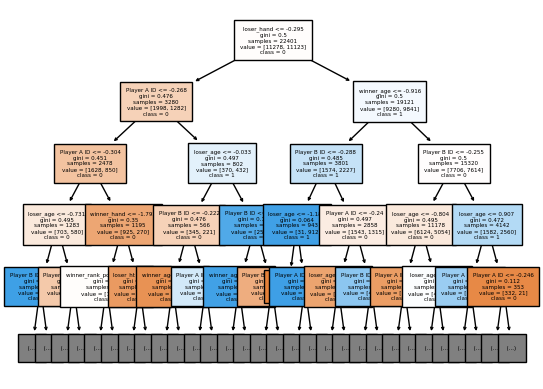

In [105]:
# Visualize the Decision Tree
#fig = plt.figure(figsize=(14,8))
tree.plot_tree(DTC,max_depth=4, 
              feature_names=['surface','tourney_level','winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','best_of','round','minutes','w_ace','w_df','w_svpt','w_1stIn','w_1stWon','w_2ndWon','w_SvGms','w_bpSaved','w_bpFaced','l_ace','l_df','l_svpt','l_1stIn','l_1stWon','l_2ndWon','l_SvGms','l_bpSaved','l_bpFaced','winner_rank_points','loser_rank_points','log tourney_date','Player A ID','Player B ID','n_sets'],
              filled=True,
              class_names=['0','1'],
              fontsize=4)
plt.show()

In [106]:
# look at the feature importances
feature_names=['surface','tourney_level','winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','best_of','round','minutes','w_ace','w_df','w_svpt','w_1stIn','w_1stWon','w_2ndWon','w_SvGms','w_bpSaved','w_bpFaced','l_ace','l_df','l_svpt','l_1stIn','l_1stWon','l_2ndWon','l_SvGms','l_bpSaved','l_bpFaced','winner_rank_points','loser_rank_points','log tourney_date','Player A ID','Player B ID','n_sets']
#dfFeatures = pd.DataFrame({'Features':feature_names.tolist(),'Importances':DTC.feature_importances_})
dfFeatures = pd.DataFrame({'Features':feature_names,'Importances':DTC.feature_importances_})
dfFeatures.sort_values(by='Importances',ascending=False).head(35)

,Features,Importances
32,Player A ID,0.306089
33,Player B ID,0.199427
7,loser_age,0.194789
4,winner_age,0.148768
30,loser_rank_points,0.019072
31,log tourney_date,0.017633
29,winner_rank_points,0.015599
6,loser_ht,0.014431
3,winner_ht,0.012033
5,loser_hand,0.007665


In [107]:
# SVM model with regularization parameter C=1 (default):
svd=SVC().fit(X_train,y_train)

print('Training accuracy: ',svd.score(X_train,y_train))
print('Testing accuracy: ',svd.score(X_test,y_test))

Training accuracy:  0.7359939288424624
Testing accuracy:  0.6669345118521495


In [228]:
# Summarize results for full dataset
df_results_full=pd.DataFrame({'Model': ['Baseline','Logistic Regression','KNN','Decision Tree', 'SVC'], 
             'Best Test Score': [0.6554171688763895,0.5685014061872238, 0.6074728806749699, 0.9241998125083701,0.6669345118521495]}).set_index('Model')
df_results_full.head()

,Best Test Score
Model,
Baseline,0.655417
Logistic Regression,0.568501
KNN,0.607473
Decision Tree,0.924200
SVC,0.666935


In [108]:
# Prepare for predictions that only use features that are known BEFORE the match
# Remove all features that are not know until after the match has been played:

In [109]:
d13_basic=d13.drop(['minutes','w_ace','w_df','w_svpt','w_1stIn','w_1stWon','w_2ndWon','w_SvGms','w_bpSaved','w_bpFaced','l_ace','l_df','l_svpt','l_1stIn','l_1stWon','l_2ndWon','l_SvGms','l_bpSaved','l_bpFaced','n_sets'],axis=1)


In [110]:
d13_basic.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,winner
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,4410.0,598.0,5.000447,104053,103429,1
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,400.0,590.0,5.000447,104958,104999,1
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,850.0,568.0,5.000447,103813,104755,0
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,151.0,1260.0,5.000447,103781,105051,0
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,1655.0,179.0,5.000447,105194,104607,0


In [111]:
d13_basic.shape

(29868, 16)

In [112]:
# Assign appropriate ranking points, hands, heights, and ages to Players A and B depending on who is the winner and loser, respectively

d13_basic['Player_A_rank_points']=np.where(d13_basic['winner']==1,d13_basic['winner_rank_points'],d13_basic['loser_rank_points'])
d13_basic['Player_B_rank_points']=np.where(d13_basic['winner']==0,d13_basic['winner_rank_points'],d13_basic['loser_rank_points'])

d13_basic['Player_A_hand']=np.where(d13_basic['winner']==1,d13_basic['winner_hand'],d13_basic['loser_hand'])
d13_basic['Player_B_hand']=np.where(d13_basic['winner']==0,d13_basic['winner_hand'],d13_basic['loser_hand'])

d13_basic['Player_A_ht']=np.where(d13_basic['winner']==1,d13_basic['winner_ht'],d13_basic['loser_ht'])
d13_basic['Player_B_ht']=np.where(d13_basic['winner']==0,d13_basic['winner_ht'],d13_basic['loser_ht'])

d13_basic['Player_A_age']=np.where(d13_basic['winner']==1,d13_basic['winner_age'],d13_basic['loser_age'])
d13_basic['Player_B_age']=np.where(d13_basic['winner']==0,d13_basic['winner_age'],d13_basic['loser_age'])

In [113]:
d13_basic.info()

<class 'pandas.core.frame.DataFrame'>
Index: 29868 entries, 151652 to 187940
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   surface               29868 non-null  int64  
 1   tourney_level         29868 non-null  int64  
 2   winner_hand           29868 non-null  int64  
 3   winner_ht             29868 non-null  float64
 4   winner_age            29868 non-null  float64
 5   loser_hand            29868 non-null  int64  
 6   loser_ht              29868 non-null  float64
 7   loser_age             29868 non-null  float64
 8   best_of               29868 non-null  int64  
 9   round                 29868 non-null  int64  
 10  winner_rank_points    29868 non-null  float64
 11  loser_rank_points     29868 non-null  float64
 12  log tourney_date      29868 non-null  float64
 13  Player A ID           29868 non-null  int64  
 14  Player B ID           29868 non-null  int64  
 15  winner            

In [114]:
y=d13_basic['winner']

In [115]:
X_unscaled_basic_corr=d13_basic.drop(['winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','winner_rank_points','loser_rank_points'],axis=1)

In [116]:
# Create dataframe for correlation matrix representing feature data that is know BEFORE the match is played
X_unscaled_basic_corr.head()

,surface,tourney_level,best_of,round,log tourney_date,Player A ID,Player B ID,winner,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age
151652,0,1,3,2,5.000447,104053,103429,1,4410.0,598.0,1,1,188.0,183.0,27.3,30.3
151653,0,1,3,2,5.000447,104958,104999,1,400.0,590.0,-1,-1,198.0,190.0,22.5,22.3
151654,0,1,3,2,5.000447,103813,104755,0,568.0,850.0,-1,1,185.0,185.0,28.4,23.5
151655,0,1,3,2,5.000447,103781,105051,0,1260.0,151.0,-1,1,183.0,188.0,28.6,22.1
151656,0,1,3,2,5.000447,105194,104607,0,179.0,1655.0,1,1,183.0,196.0,21.4,24.2


In [117]:
# Create correlation matrix for basic features and target feature
# Conclusion is that the features that have by far the highest correlations are the rank points of Player A and Player B - not a surprise!
# After that comes player heights, but the correlation is rather weak
corr_matrix_basic=X_unscaled_basic_corr.corr()
print(corr_matrix_basic)

                       surface  tourney_level   best_of     round  \
surface               1.000000       0.098741  0.143594 -0.078418   
tourney_level         0.098741       1.000000  0.864687 -0.531899   
best_of               0.143594       0.864687  1.000000 -0.442063   
round                -0.078418      -0.531899 -0.442063  1.000000   
log tourney_date      0.009155       0.001709  0.007160  0.011742   
Player A ID           0.025904      -0.012391 -0.008264  0.012699   
Player B ID          -0.002187      -0.028392 -0.023368  0.020377   
winner               -0.003085      -0.001609  0.001436 -0.008747   
Player_A_rank_points  0.019063       0.165266  0.090167  0.227443   
Player_B_rank_points  0.012959       0.170074  0.087056  0.231663   
Player_A_hand         0.020114       0.020750  0.015636  0.027445   
Player_B_hand         0.047735      -0.003389 -0.003091 -0.013258   
Player_A_ht           0.068953       0.028156  0.011237  0.054406   
Player_B_ht           0.061345    

In [118]:
##X_unscaled_basic=d13_basic.drop(['winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','winner_rank_points','loser_rank_points','winner','121idx'],axis=1)
X_unscaled_basic=d13_basic.drop(['winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','winner_rank_points','loser_rank_points','winner'],axis=1)

In [119]:
X_unscaled_basic.head()

,surface,tourney_level,best_of,round,log tourney_date,Player A ID,Player B ID,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age
151652,0,1,3,2,5.000447,104053,103429,4410.0,598.0,1,1,188.0,183.0,27.3,30.3
151653,0,1,3,2,5.000447,104958,104999,400.0,590.0,-1,-1,198.0,190.0,22.5,22.3
151654,0,1,3,2,5.000447,103813,104755,568.0,850.0,-1,1,185.0,185.0,28.4,23.5
151655,0,1,3,2,5.000447,103781,105051,1260.0,151.0,-1,1,183.0,188.0,28.6,22.1
151656,0,1,3,2,5.000447,105194,104607,179.0,1655.0,1,1,183.0,196.0,21.4,24.2


In [120]:
# Standardize input data
scaler_basic=StandardScaler()
X2=scaler_basic.fit_transform(X_unscaled_basic)

In [121]:
print(X2)

[[ 0.32896497 -0.75552716 -0.49200368 ... -0.57257011  0.04776612
   0.65237686]
 [ 0.32896497 -0.75552716 -0.49200368 ...  0.43173087 -1.12605224
  -1.30463824]
 [ 0.32896497 -0.75552716 -0.49200368 ... -0.28562697  0.31676616
  -1.01108597]
 ...
 [ 0.32896497 -2.01311105 -0.49200368 ...  0.14478773 -0.8081431
   1.89997398]
 [ 0.32896497 -2.01311105 -0.49200368 ... -0.57257011 -0.51468851
  -0.93769791]
 [ 0.32896497 -2.01311105 -0.49200368 ...  0.86214558  2.02858459
  -0.64414564]]


In [122]:
# Train, test, split
X2_train, X2_test, y_train, y_test=train_test_split(X2,y)
X2_train.shape

(22401, 15)

In [203]:
# Logistic Regression for basic X2 feature (only features known before match) set with penalty strength parameter 
# C=1 (default)
lr2=LogisticRegression().fit(X2_train,y_train)

print('Training accuracy: ',lr2.score(X2_train,y_train))
print('Testing accuracy: ',lr2.score(X2_test,y_test))

Training accuracy:  0.6526047944288201
Testing accuracy:  0.6618454533279764


In [204]:
# Try to improve Logistic Regression results with GridSearchCV
# Conclusion: C=1 gives best result

#params = {'lr2__C': [0.01,0.1, 1, 10, 100]}
params={'C':[0.01,0.1,1,10,100]}

grid_lr2=GridSearchCV(lr2,param_grid=params)
grid_lr2.fit(X2_train,y_train)
print(grid_lr2.best_params_)

{'C': 1}


In [125]:
# KNN model with K=5 (default value):
KNN2=KNeighborsClassifier().fit(X2_train,y_train)

print('Training accuracy: ',KNN2.score(X2_train,y_train))
print('Testing accuracy: ',KNN2.score(X2_test,y_test))

Training accuracy:  0.7388509441542789
Testing accuracy:  0.5998392928887103


In [206]:
# Try to improve KNN results with GridSearchCV
# Conclusion: K=13 gives best result (but not significantly better than K=5)

params={'n_neighbors':range(1,21,2)}

grid_KNN2=GridSearchCV(KNN2,param_grid=params)
grid_KNN2.fit(X2_train,y_train)
print(grid_KNN2.best_params_)

{'n_neighbors': 13}


In [207]:
# Run KNN with n_neighbors=13

KNN2=KNeighborsClassifier(n_neighbors=13).fit(X2_train,y_train)

print('Training accuracy: ',KNN2.score(X2_train,y_train))
print('Testing accuracy: ',KNN2.score(X2_test,y_test))

Training accuracy:  0.6802821302620419
Testing accuracy:  0.6006428284451587


In [126]:
# Decision Tree model with max_depth=None (default):
DTC2=DecisionTreeClassifier().fit(X2_train,y_train)

print('Training accuracy: ',DTC2.score(X2_train,y_train))
print('Testing accuracy: ',DTC2.score(X2_test,y_test))

Training accuracy:  1.0
Testing accuracy:  0.5821615106468461


In [210]:
# Try to improve DTC with GridSearchCV

params={'criterion':['gini','entropy'],'max_depth':range(1,10),'min_samples_split':range(2,10),'min_samples_leaf':range(1,5)}

grid_DTC2=GridSearchCV(DTC2,param_grid=params)
grid_DTC2.fit(X2_train,y_train)
print(grid_DTC2.best_params_)

{'criterion': 'entropy', 'max_depth': 6, 'min_samples_leaf': 4, 'min_samples_split': 2}


In [212]:
# Run Decision Tree model with {'criterion': 'entropy', 'max_depth': 6, 'min_samples_leaf': 4, 'min_samples_split': 2}:
# Conclusion: The below hyperparameter selection does improve performance significantly, but it's still not better than baseline performance 

DTC2=DecisionTreeClassifier(criterion='entropy',max_depth=6,min_samples_leaf=4,min_samples_split=2).fit(X2_train,y_train)

print('Training accuracy: ',DTC2.score(X2_train,y_train))
print('Testing accuracy: ',DTC2.score(X2_test,y_test))

Training accuracy:  0.6622472211062006
Testing accuracy:  0.660372304807821


In [127]:
# SVM model with regularization parameter C=1 (default):
svd2=SVC().fit(X2_train,y_train)

print('Training accuracy: ',svd2.score(X2_train,y_train))
print('Testing accuracy: ',svd2.score(X2_test,y_test))

Training accuracy:  0.6803714119905362
Testing accuracy:  0.6547475559126825


In [213]:
# Try to improve SVM model with GridSearchCV:

params= {'C':[0.1, 1, 10],'gamma':[1, 0.1, 0.01],'kernel':['rbf']}  

grid_svd2=GridSearchCV(svd2,param_grid=params)
grid_svd2.fit(X2_train,y_train)
print(grid_svd2.best_params_)

{'C': 10, 'gamma': 0.01, 'kernel': 'rbf'}


In [215]:
# Run SVM model with {'C': 10, 'gamma': 0.01, 'kernel': 'rbf'}
# Conclusion: the hyperparameter selection based on GridSearchCV doesn't significantly change the performance, which is essentially
# on par with the baseline performance

svd2=SVC(C=10,gamma=0.01,kernel='rbf').fit(X2_train,y_train)

print('Training accuracy: ',svd2.score(X2_train,y_train))
print('Testing accuracy: ',svd2.score(X2_test,y_test))

Training accuracy:  0.6615776081424937
Testing accuracy:  0.6609079951787866


In [217]:
# Conclusion: none of the above models can do a better job than the baseline performance accuracy of 0.655

In [229]:
# Summarize results for basic dataset
df_results_basic=pd.DataFrame({'Model': ['Baseline','Logistic Regression','KNN','Decision Tree', 'SVC'], 
             'Best Test Score': [0.6554171688763895,0.6618454533279764,0.6006428284451587,0.660372304807821,0.6609079951787866]}).set_index('Model')
df_results_basic.head()

,Best Test Score
Model,
Baseline,0.655417
Logistic Regression,0.661845
KNN,0.600643
Decision Tree,0.660372
SVC,0.660908


In [129]:
# Add 121idx feature to X
##X_unscaled_basic_121idx=d13_basic.drop(['winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','winner_rank_points','loser_rank_points','winner'],axis=1)

In [130]:
##X_unscaled_basic_121idx.head()

In [131]:
# Standardize input data
##scaler_basic_121idx=StandardScaler()
##X3=scaler_basic_121idx.fit_transform(X_unscaled_basic_121idx)

In [132]:
##print(X3)

In [133]:
# Train, test, split
##X3_train, X3_test, y_train, y_test=train_test_split(X3,y)
##X3_train.shape

In [134]:
# Logistic Regression for basic X3 with 121idx feature set with penalty strength parameter C=1 (default)
##lr=LogisticRegression().fit(X3_train,y_train)

##print('Training accuracy: ',lr.score(X3_train,y_train))
##print('Testing accuracy: ',lr.score(X3_test,y_test))

In [135]:
# KNN model with K=5 (default value):
##KNN=KNeighborsClassifier().fit(X3_train,y_train)

##print('Training accuracy: ',KNN.score(X3_train,y_train))
##print('Testing accuracy: ',KNN.score(X3_test,y_test))

In [136]:
# Decision Tree model with max_depth=None (default):
##DTC=DecisionTreeClassifier().fit(X3_train,y_train)

##print('Training accuracy: ',DTC.score(X3_train,y_train))
##print('Testing accuracy: ',DTC.score(X3_test,y_test))

In [137]:
# SVM model with regularization parameter C=1 (default):
##svd=SVC().fit(X3_train,y_train)

##print('Training accuracy: ',svd.score(X3_train,y_train))
##print('Testing accuracy: ',svd.score(X3_test,y_test))

In [138]:
# Add 121idx feature to X
##X_unscaled_basic_121idx_corr=d13_basic.drop(['winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','winner_rank_points','loser_rank_points'],axis=1)

In [139]:
##X_unscaled_basic_121idx_corr.head()

In [140]:
##corr_matrix_121idx=X_unscaled_basic_121idx_corr.corr()
##print(corr_matrix_121idx)

In [141]:
# Train model on all matches played by certain player, such as Novak Djokovic with player ID = 104925

In [142]:
# Create dataset with all matches that Djokovic has played since 2010
nd=d13[(d13['Player A ID']==104925)|(d13['Player B ID']==104925)]

In [143]:
nd.shape

(747, 36)

In [144]:
nd.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,winner,n_sets
151815,0,3,1,188.0,22.6,1,185.0,24.4,5,0,...,14.0,9.0,14.0,8310.0,613.0,5.000512,104593,104925,0,3
151871,0,3,1,188.0,22.6,1,185.0,28.3,5,1,...,16.0,10.0,18.0,8310.0,775.0,5.000512,103843,104925,0,4
151899,0,3,1,188.0,22.6,1,188.0,23.3,5,2,...,11.0,5.0,14.0,8310.0,515.0,5.000512,104797,104925,0,3
151913,0,3,1,188.0,22.6,1,190.0,27.6,5,3,...,13.0,3.0,9.0,8310.0,573.0,5.000512,103997,104925,0,3
151920,0,3,1,188.0,24.7,1,188.0,22.6,5,4,...,24.0,4.0,11.0,2875.0,8310.0,5.000512,104542,104925,1,5


In [145]:
nd.info()

<class 'pandas.core.frame.DataFrame'>
Index: 747 entries, 151815 to 187940
Data columns (total 36 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   surface             747 non-null    int64  
 1   tourney_level       747 non-null    int64  
 2   winner_hand         747 non-null    int64  
 3   winner_ht           747 non-null    float64
 4   winner_age          747 non-null    float64
 5   loser_hand          747 non-null    int64  
 6   loser_ht            747 non-null    float64
 7   loser_age           747 non-null    float64
 8   best_of             747 non-null    int64  
 9   round               747 non-null    int64  
 10  minutes             747 non-null    float64
 11  w_ace               747 non-null    float64
 12  w_df                747 non-null    float64
 13  w_svpt              747 non-null    float64
 14  w_1stIn             747 non-null    float64
 15  w_1stWon            747 non-null    float64
 16  w_2nd

In [146]:
nd['winner'].value_counts()

winner
0    484
1    263
Name: count, dtype: int64

In [147]:
nd_corr=nd.corr()
print(nd_corr)

                     surface  tourney_level  winner_hand  winner_ht  \
surface             1.000000       0.033250     0.166972   0.082687   
tourney_level       0.033250       1.000000    -0.033423  -0.070075   
winner_hand         0.166972      -0.033423     1.000000   0.079482   
winner_ht           0.082687      -0.070075     0.079482   1.000000   
winner_age         -0.016577       0.017033    -0.024665  -0.097926   
loser_hand          0.008282       0.032235    -0.059722   0.007649   
loser_ht            0.073031      -0.056523    -0.018033   0.002310   
loser_age           0.006447      -0.040022    -0.010634   0.043695   
best_of             0.185705       0.832423    -0.007866  -0.054898   
round              -0.040338      -0.281377    -0.149434  -0.002045   
minutes             0.008635       0.437386    -0.154566  -0.058626   
w_ace               0.366169       0.220275     0.075283   0.251492   
w_df                0.105295       0.139393    -0.010271   0.014873   
w_svpt

In [148]:
ynd=nd['winner']

In [149]:
X_unscaled_nd=nd.drop(['winner'],axis=1)

In [150]:
# Standardize input data
scaler_nd=StandardScaler()
Xnd=scaler_nd.fit_transform(X_unscaled_nd)

In [151]:
# Train, test, split
Xnd_train, Xnd_test, ynd_train, ynd_test=train_test_split(Xnd,ynd)
Xnd_train.shape

(560, 35)

In [152]:
# Calculate baseline performance with prediction based only on the rank points of the two players (one of them being Novak Djokovic):
error=0
for i in range(0,nd.shape[0]):
    if (nd['winner_rank_points'].iloc[i]<nd['loser_rank_points'].iloc[i]): # Winner has lower rank points than loser
        error=error+1
print('Baseline performance accuracy is: ',1-error/nd.shape[0])

Baseline performance accuracy is:  0.8433734939759037


In [153]:
# Logistic Regression with penalty strength parameter C=1 (default)
lr_nd=LogisticRegression().fit(Xnd_train,ynd_train)

print('Training accuracy: ',lr_nd.score(Xnd_train,ynd_train))
print('Testing accuracy: ',lr_nd.score(Xnd_test,ynd_test))

Training accuracy:  0.7482142857142857
Testing accuracy:  0.7593582887700535


In [154]:
# KNN model with K=5 (default value):
KNN_nd=KNeighborsClassifier().fit(Xnd_train,ynd_train)

print('Training accuracy: ',KNN_nd.score(Xnd_train,ynd_train))
print('Testing accuracy: ',KNN_nd.score(Xnd_test,ynd_test))

Training accuracy:  0.8
Testing accuracy:  0.7005347593582888


In [155]:
# Decision Tree model with max_depth=None (default):
DTC_nd=DecisionTreeClassifier().fit(Xnd_train,ynd_train)

print('Training accuracy: ',DTC_nd.score(Xnd_train,ynd_train))
print('Testing accuracy: ',DTC_nd.score(Xnd_test,ynd_test))

Training accuracy:  1.0
Testing accuracy:  0.9946524064171123


In [156]:
# SVM model with regularization parameter C=1 (default):
svd_nd=SVC().fit(Xnd_train,ynd_train)

print('Training accuracy: ',svd_nd.score(Xnd_train,ynd_train))
print('Testing accuracy: ',svd_nd.score(Xnd_test,ynd_test))

Training accuracy:  0.8125
Testing accuracy:  0.7593582887700535


In [157]:
# Conclusion: Only the DTC model could do a better job than the baseline performance at 0.97 accuracy vs 0.84

In [230]:
# Summarize results for dataset with Djokovic matches
df_results_djoko=pd.DataFrame({'Model': ['Baseline','Logistic Regression','KNN','Decision Tree', 'SVC'], 
             'Best Test Score': [0.8433734939759037,0.7593582887700535,0.7005347593582888,0.9946524064171123,0.7593582887700535]}).set_index('Model')
df_results_djoko.head()

,Best Test Score
Model,
Baseline,0.843373
Logistic Regression,0.759358
KNN,0.700535
Decision Tree,0.994652
SVC,0.759358


In [158]:
# Visualizations

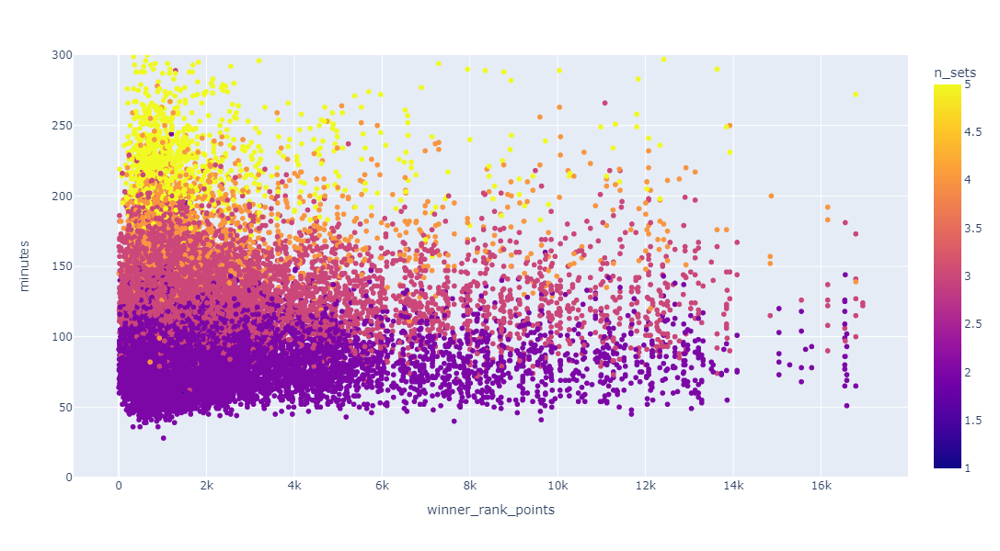

In [159]:
fig=px.scatter(d13,x='winner_rank_points',y='minutes',color='n_sets')
fig.update_layout(autosize=False,width=1000,height=600)
fig.update_yaxes(range=[0,300])

In [3]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='winner_rank_points',y='minutes',color='surface')
#fig.update_layout(autosize=False,width=1000,height=600)
#fig.update_yaxes(range=[0,300])

In [4]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#px.scatter(d13,x='winner_age',y='loser_age',color='n_sets')

In [5]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#px.scatter(d13,x='minutes',y='winner_age',color='n_sets')

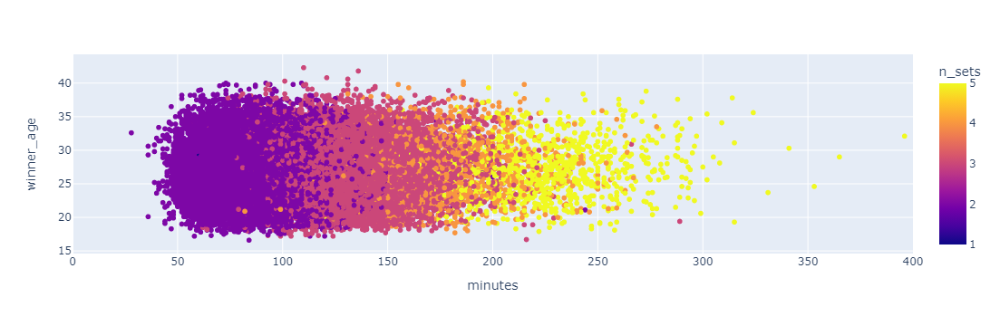

In [163]:
fig=px.scatter(d13,x='minutes',y='winner_age',color='n_sets')
fig.update_xaxes(range=[0,400])

In [6]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='minutes',y='winner_age',color='surface')
#fig.update_xaxes(range=[0,400])

In [7]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='winner_rank_points',y='loser_rank_points',color='n_sets')
#fig.update_layout(autosize=False,width=1000,height=1000)

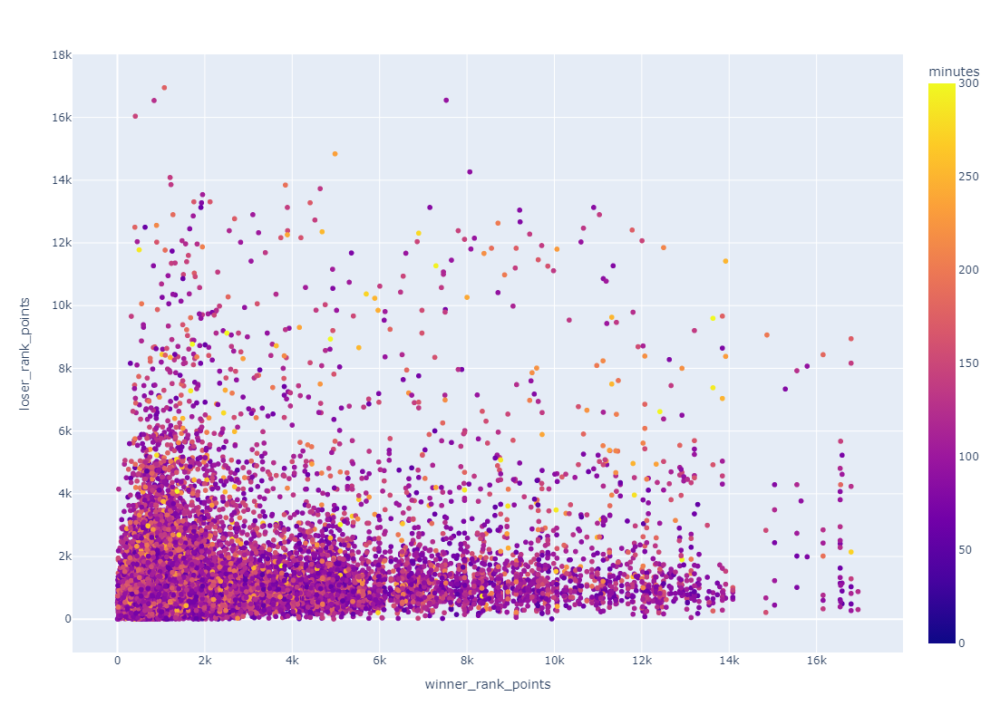

In [166]:
fig=px.scatter(d13,x='winner_rank_points',y='loser_rank_points',color='minutes',range_color=(0,300))
fig.update_layout(autosize=False,width=800,height=800)

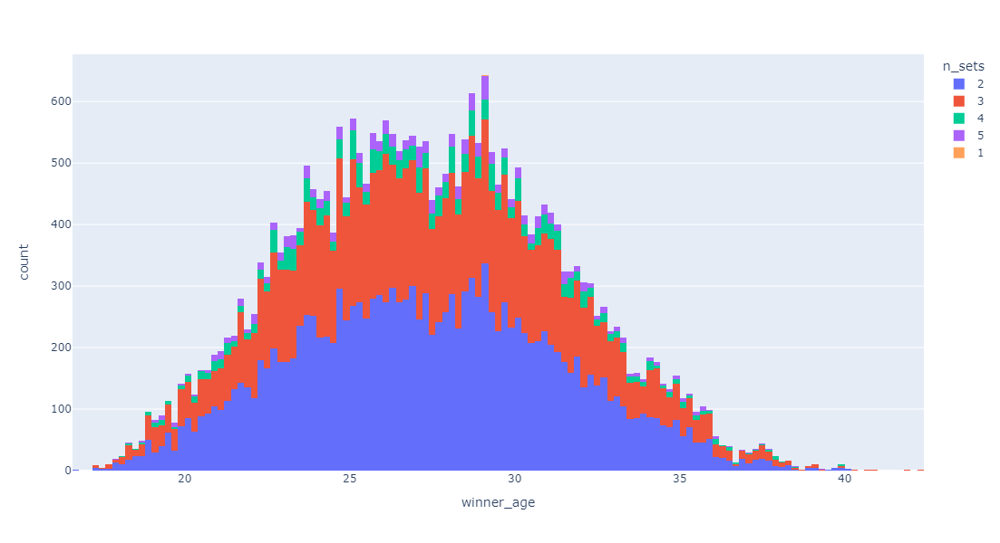

In [167]:
fig=px.histogram(d13,x='winner_age',color='n_sets')
fig.update_layout(autosize=False,width=800,height=600)

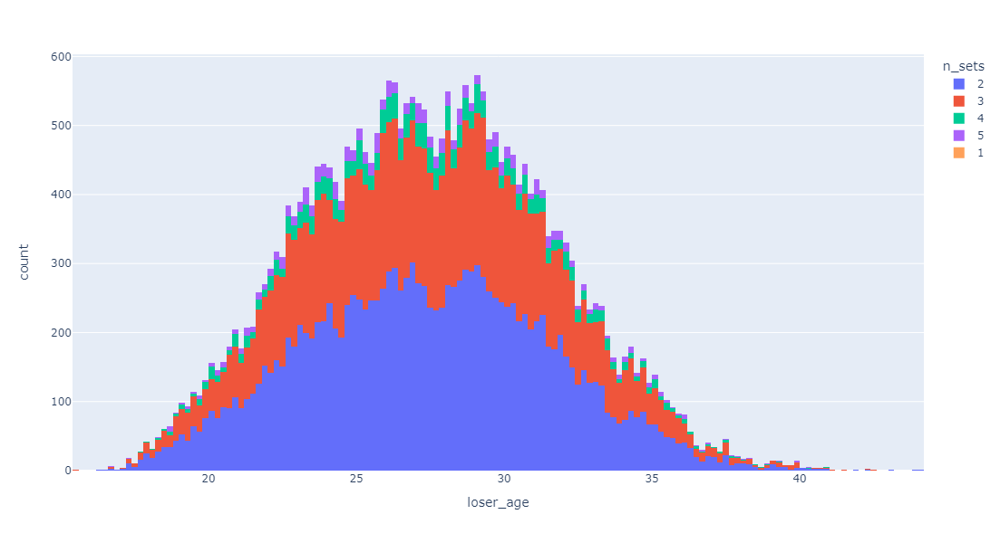

In [168]:
fig=px.histogram(d13,x='loser_age',color='n_sets')
fig.update_layout(autosize=False,width=800,height=600)

In [9]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='w_1stWon',y='l_1stWon',color='minutes',range_color=(0,400))
#fig.update_layout(autosize=False,width=700,height=700)
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

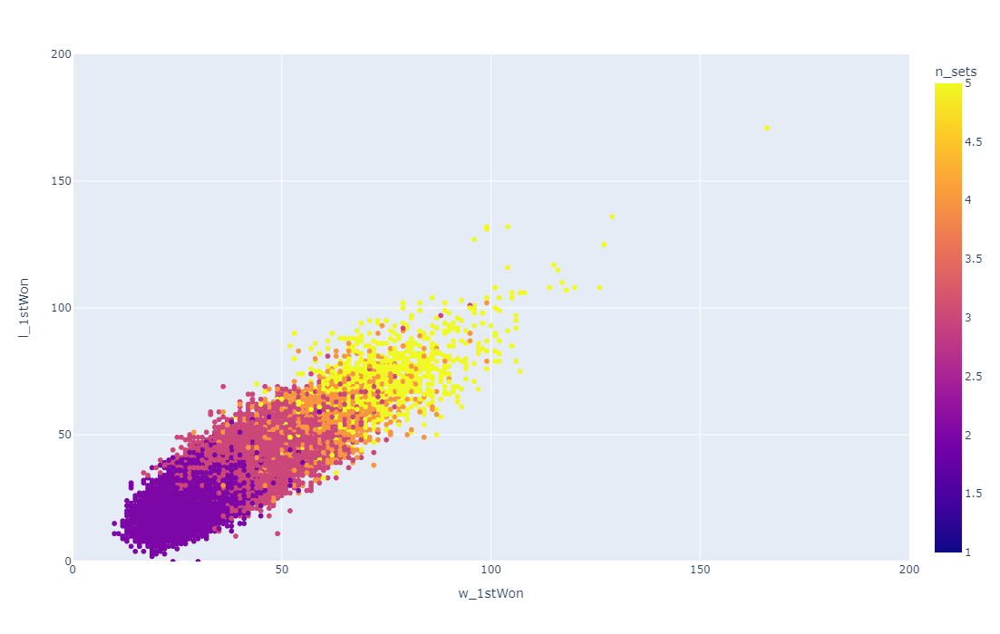

In [170]:
fig=px.scatter(d13,x='w_1stWon',y='l_1stWon',color='n_sets')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

In [8]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='w_1stWon',y='l_1stWon',color='winner_rank_points')
#fig.update_layout(autosize=False,width=700,height=700)
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

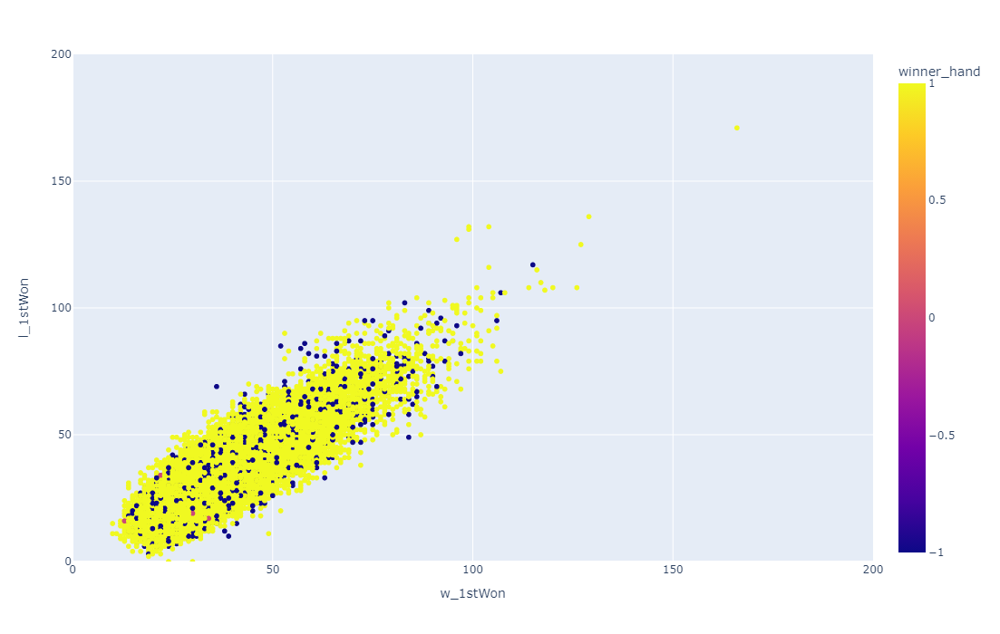

In [172]:
fig=px.scatter(d13,x='w_1stWon',y='l_1stWon',color='winner_hand')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

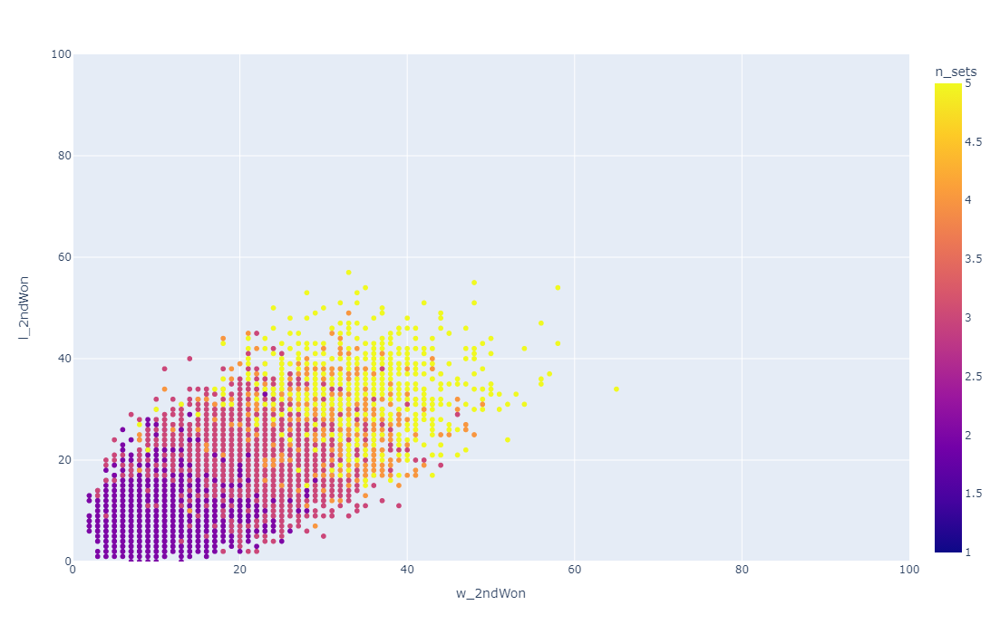

In [173]:
fig=px.scatter(d13,x='w_2ndWon',y='l_2ndWon',color='n_sets')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,100])
fig.update_yaxes(range=[0,100])

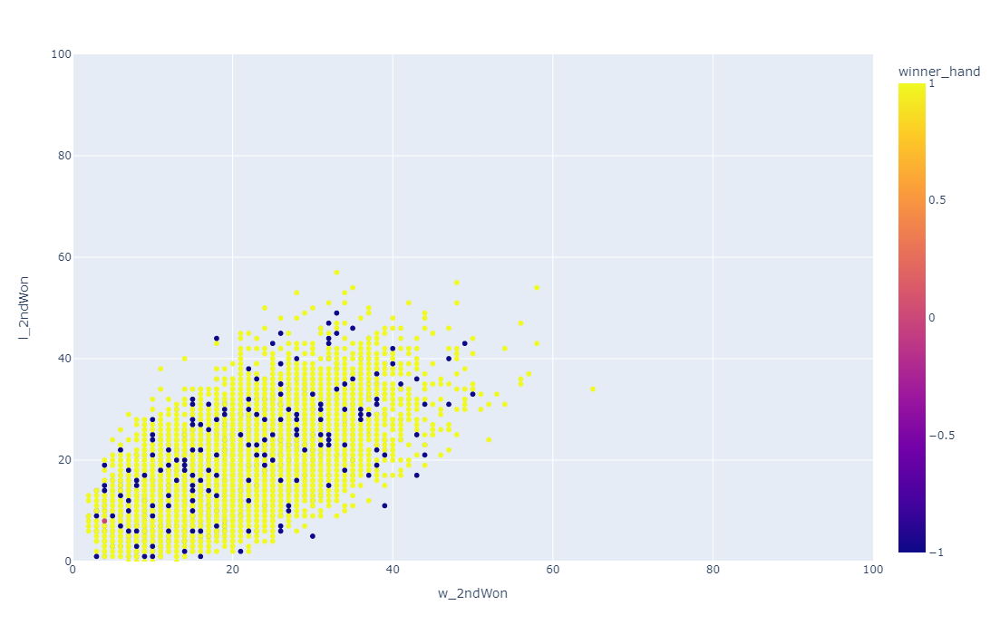

In [174]:
fig=px.scatter(d13,x='w_2ndWon',y='l_2ndWon',color='winner_hand')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,100])
fig.update_yaxes(range=[0,100])

In [175]:
# Investigate five-set matches to understand what sets the winnner apart from the loser

In [176]:
five_set=d13[d13['n_sets']==5]

In [177]:
five_set.shape

(1105, 36)

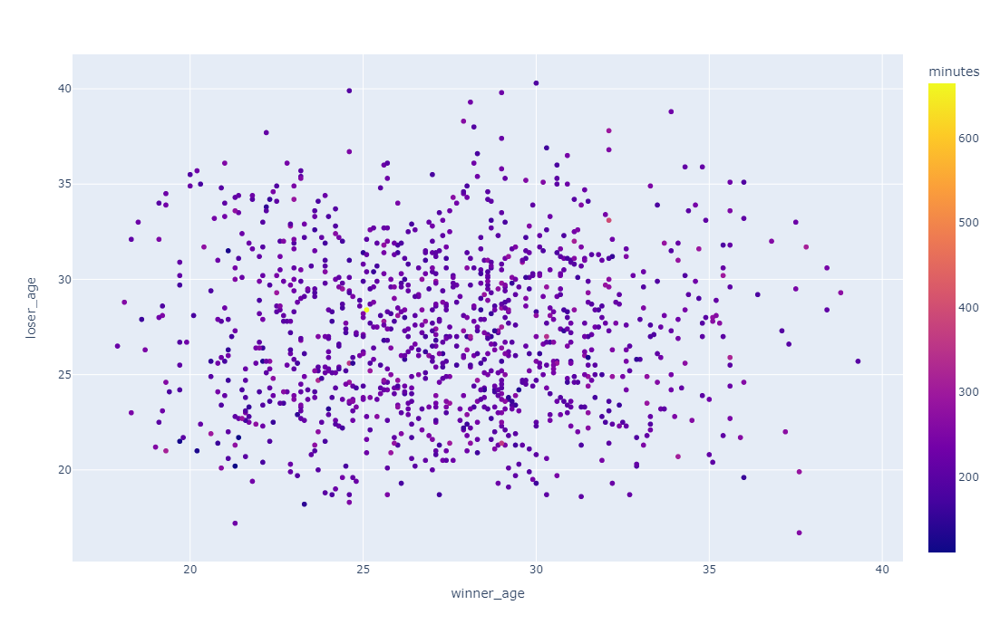

In [178]:
fig=px.scatter(five_set,x='winner_age',y='loser_age',color='minutes')
fig.update_layout(autosize=False,width=700,height=700)

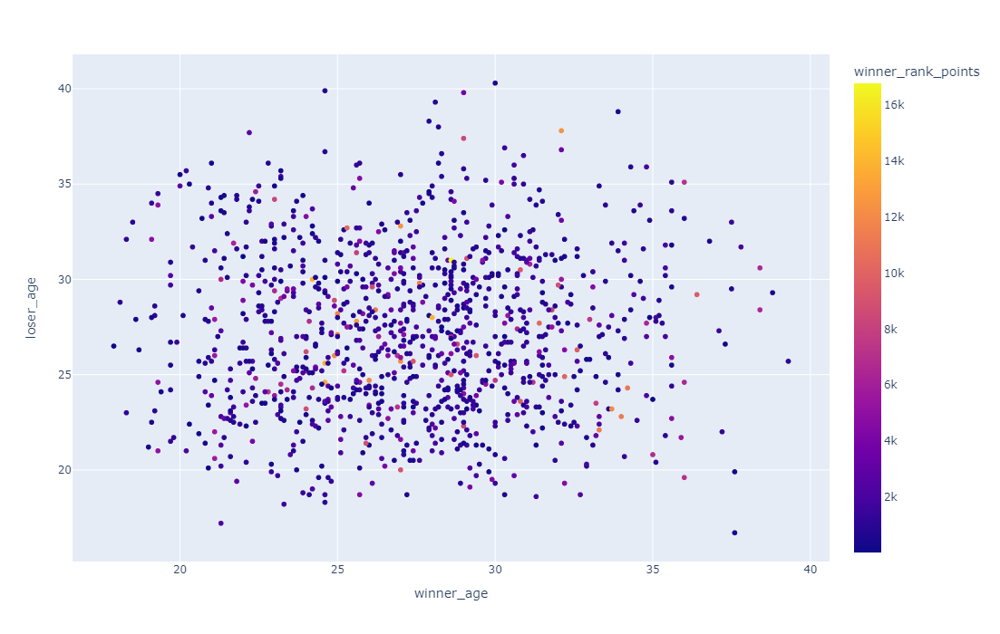

In [179]:
fig=px.scatter(five_set,x='winner_age',y='loser_age',color='winner_rank_points')
fig.update_layout(autosize=False,width=700,height=700)

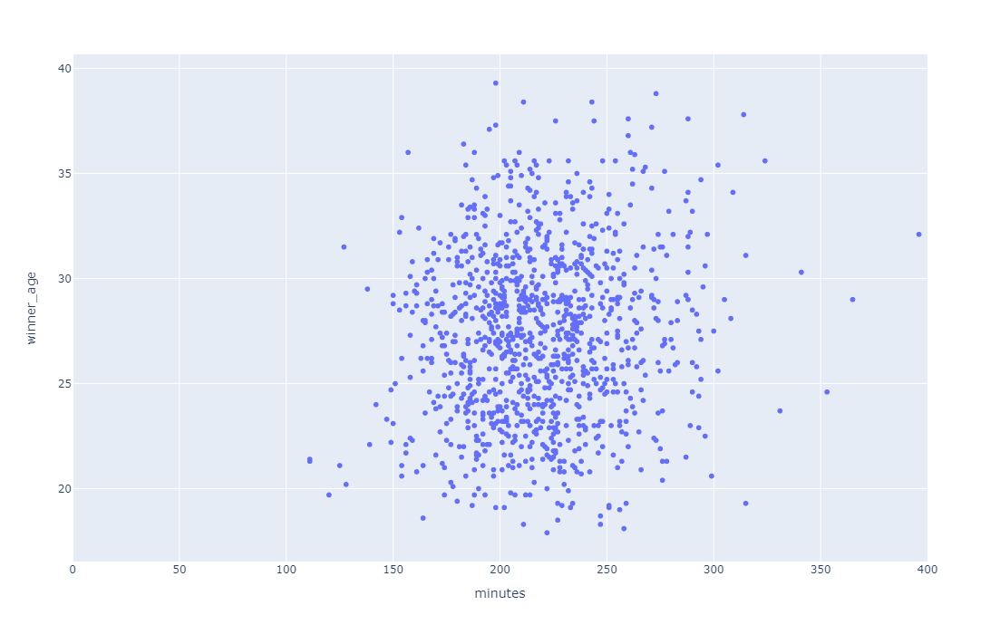

In [180]:
fig=px.scatter(five_set,x='minutes',y='winner_age')
fig.update_xaxes(range=[0,400])
fig.update_layout(autosize=False,width=700,height=700)

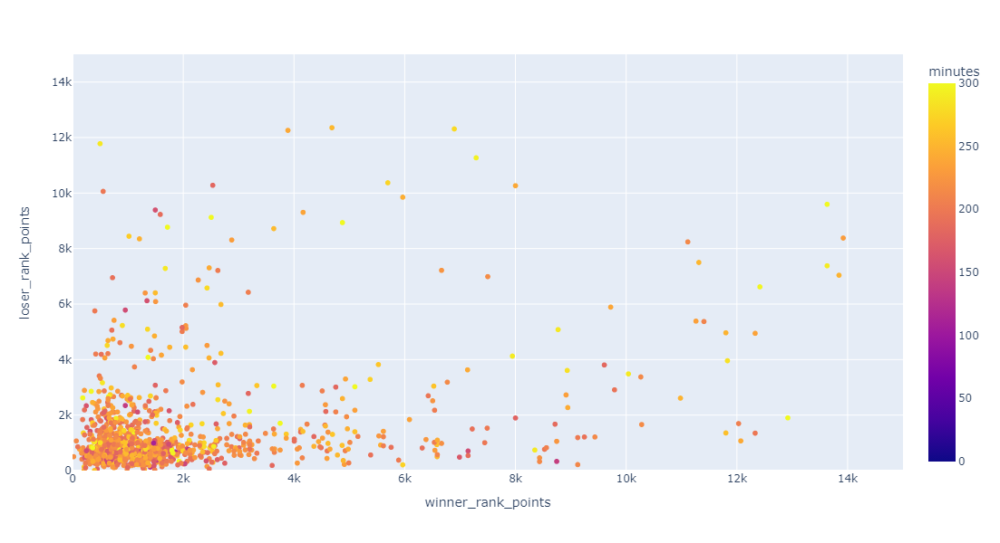

In [181]:
fig=px.scatter(five_set,x='winner_rank_points',y='loser_rank_points',color='minutes',range_color=(0,300))
fig.update_layout(autosize=False,width=600,height=600)
fig.update_xaxes(range=[0,15000])
fig.update_yaxes(range=[0,15000])

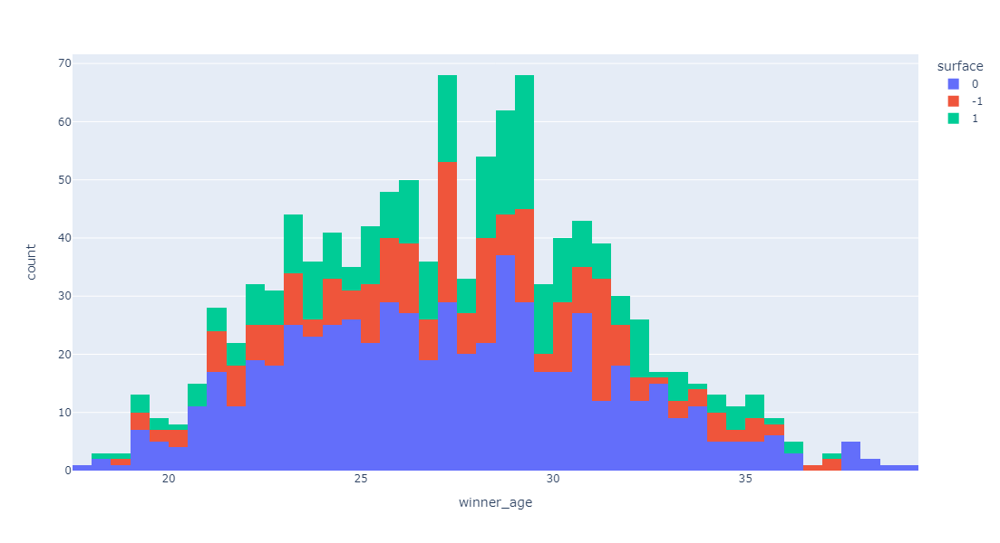

In [182]:
fig=px.histogram(five_set,x='winner_age',color='surface')
fig.update_layout(autosize=False,width=800,height=600)

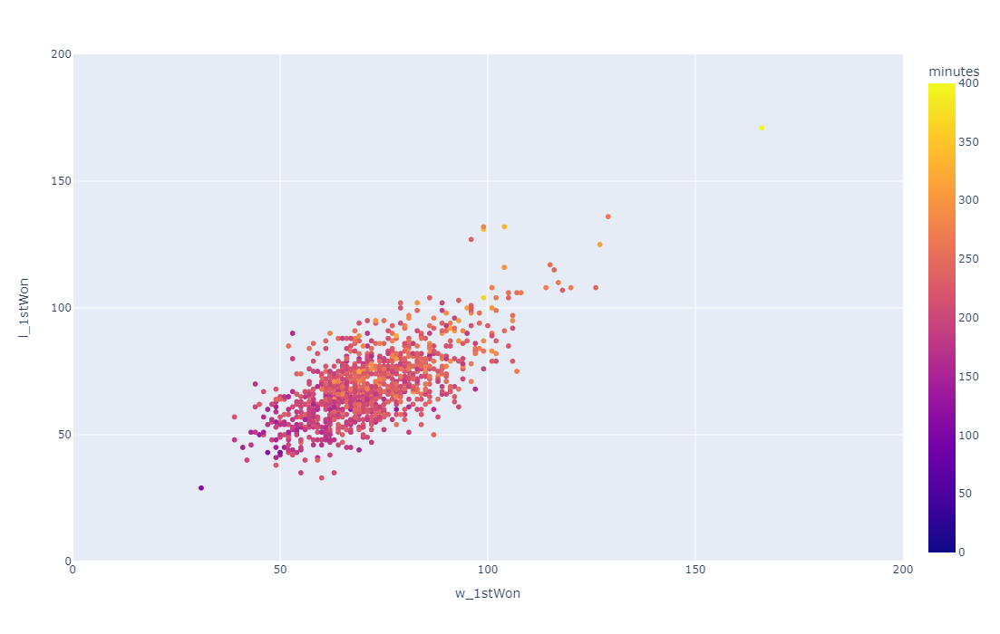

In [183]:
fig=px.scatter(five_set,x='w_1stWon',y='l_1stWon',color='minutes',range_color=(0,400))
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

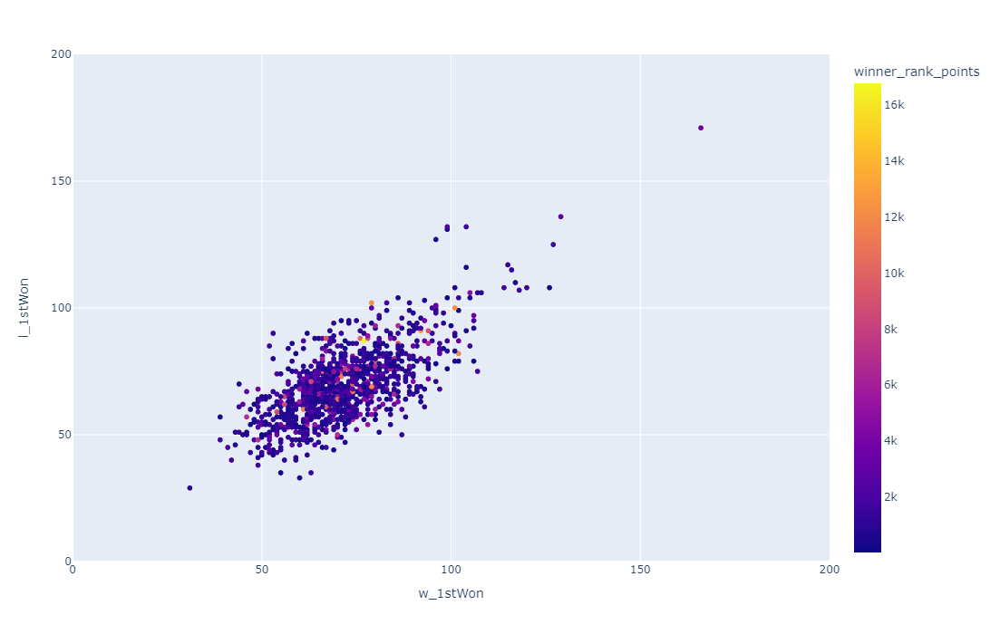

In [184]:
fig=px.scatter(five_set,x='w_1stWon',y='l_1stWon',color='winner_rank_points')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

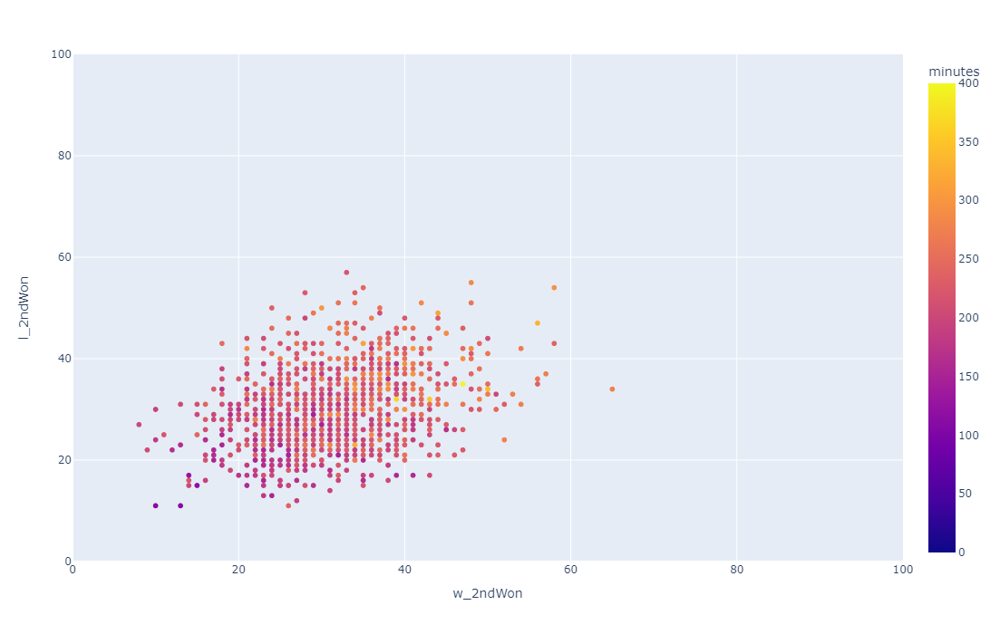

In [185]:
fig=px.scatter(five_set,x='w_2ndWon',y='l_2ndWon',color='minutes',range_color=(0,400))
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,100])
fig.update_yaxes(range=[0,100])

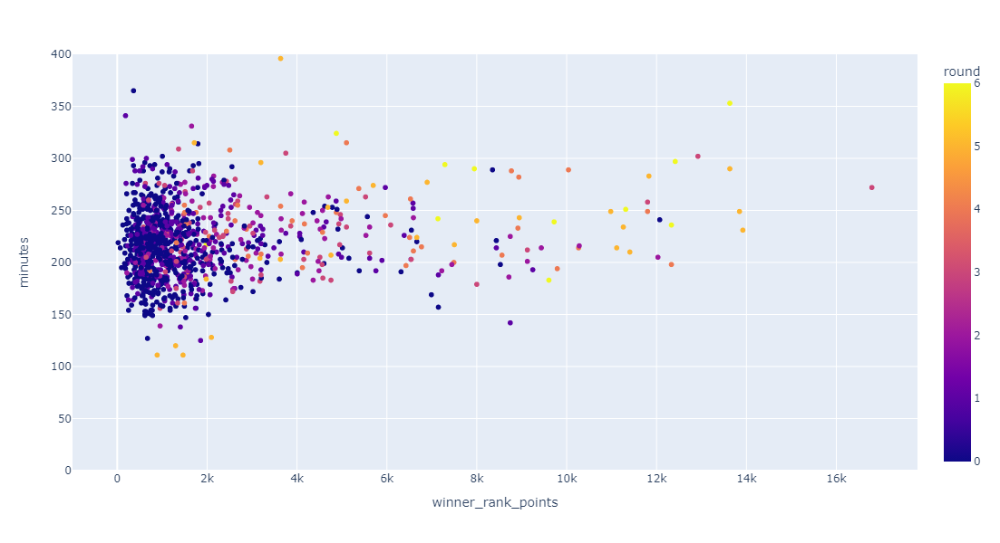

In [186]:
fig=px.scatter(five_set,x='winner_rank_points',y='minutes',color='round')
fig.update_layout(autosize=False,width=1000,height=600)
fig.update_yaxes(range=[0,400])

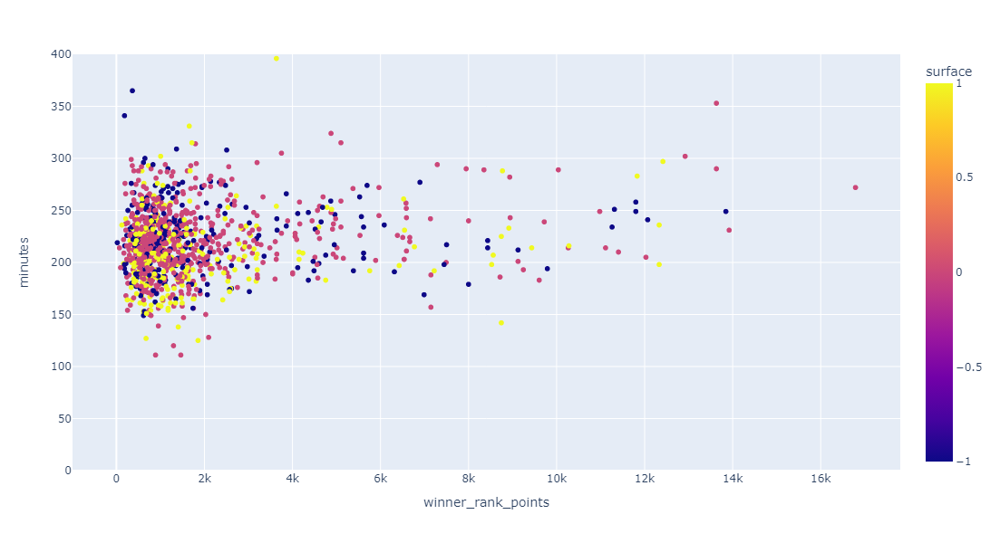

In [187]:
fig=px.scatter(five_set,x='winner_rank_points',y='minutes',color='surface')
fig.update_layout(autosize=False,width=1000,height=600)
fig.update_yaxes(range=[0,400])

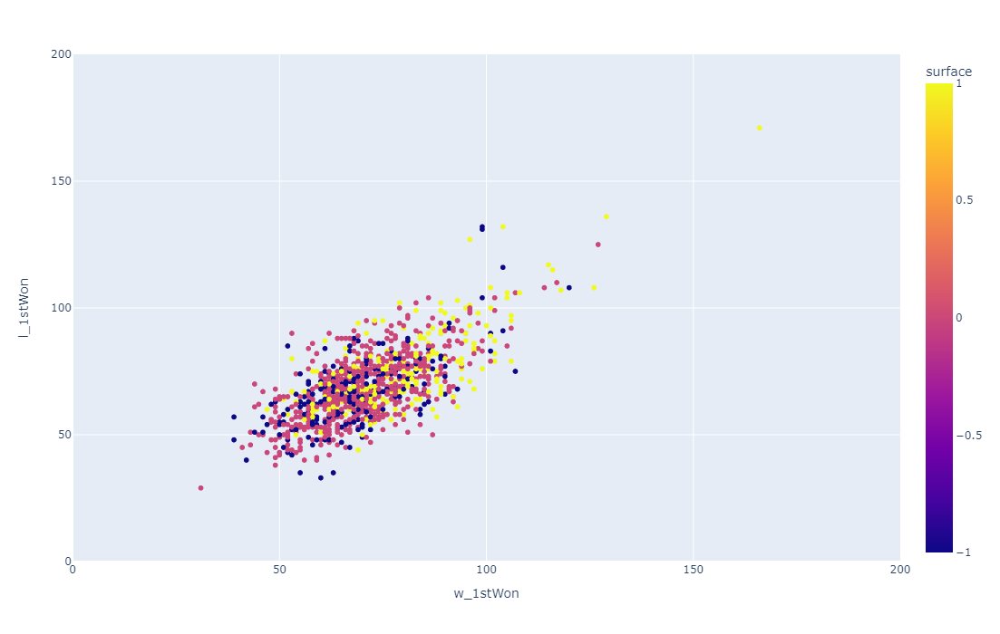

In [188]:
fig=px.scatter(five_set,x='w_1stWon',y='l_1stWon',color='surface')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

In [189]:
# Create additional metrics w_1stWonPerct and l_1stWonPerct, which measure how many first serve points were won as a 
# percentage of total number of serves for the winner and the loser, respectively. 
# Also create metrics w_bpLostPerct and l_bpLostPerct, which measure how many breakpoints while serving were lost as a 
# percentage of total number of serves for the winner and the loser, respectively 

five_set2=five_set.copy()

five_set2['w_1stWonPerct']=100*five_set2['w_1stWon']/five_set2['w_svpt']
five_set2['l_1stWonPerct']=100*five_set2['l_1stWon']/five_set2['l_svpt']

five_set2['w_2ndWonPerct']=100*five_set2['w_2ndWon']/five_set2['w_svpt']
five_set2['l_2ndWonPerct']=100*five_set2['l_2ndWon']/five_set2['l_svpt']

five_set2['w_bpLostPerct']=100*(five_set2['w_bpFaced']-five_set2['w_bpSaved'])/five_set2['w_svpt']
five_set2['l_bpLostPerct']=100*(five_set2['l_bpFaced']-five_set2['l_bpSaved'])/five_set2['l_svpt']

In [190]:
five_set2.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,Player A ID,Player B ID,winner,n_sets,w_1stWonPerct,l_1stWonPerct,w_2ndWonPerct,l_2ndWonPerct,w_bpLostPerct,l_bpLostPerct
151809,0,3,-1,175.0,33.0,1,193.0,25.8,5,0,...,104330,102905,0,5,42.281879,40.645161,24.832215,20.645161,1.342282,3.225806
151810,0,3,1,183.0,25.0,1,183.0,29.9,5,0,...,104471,103507,1,5,40.441176,44.186047,18.382353,14.728682,3.676471,4.651163
151819,0,3,1,183.0,27.5,1,185.0,23.5,5,0,...,104022,104755,1,5,42.021277,45.251397,21.276596,16.759777,3.191489,3.351955
151827,0,3,1,183.0,24.4,1,185.0,29.5,5,0,...,104597,103598,1,5,44.970414,42.245989,23.076923,24.064171,2.366864,1.604278
151830,0,3,1,190.0,23.7,1,193.0,25.4,5,0,...,104719,104417,1,5,40.140845,41.139241,20.422535,17.721519,4.225352,4.430380


In [191]:
five_set2['w_1stWonPerct'].mean()

45.525958650131635

In [192]:
five_set2['l_1stWonPerct'].mean()

43.16635376083921

In [193]:
five_set2['w_bpLostPerct'].mean()

2.8101595656319507

In [194]:
five_set2['l_bpLostPerct'].mean()

3.7119947141547636

In [195]:
five_set2['w_2ndWonPerct'].mean()

19.76416300800698

In [196]:
five_set2['l_2ndWonPerct'].mean()

18.90593115221921

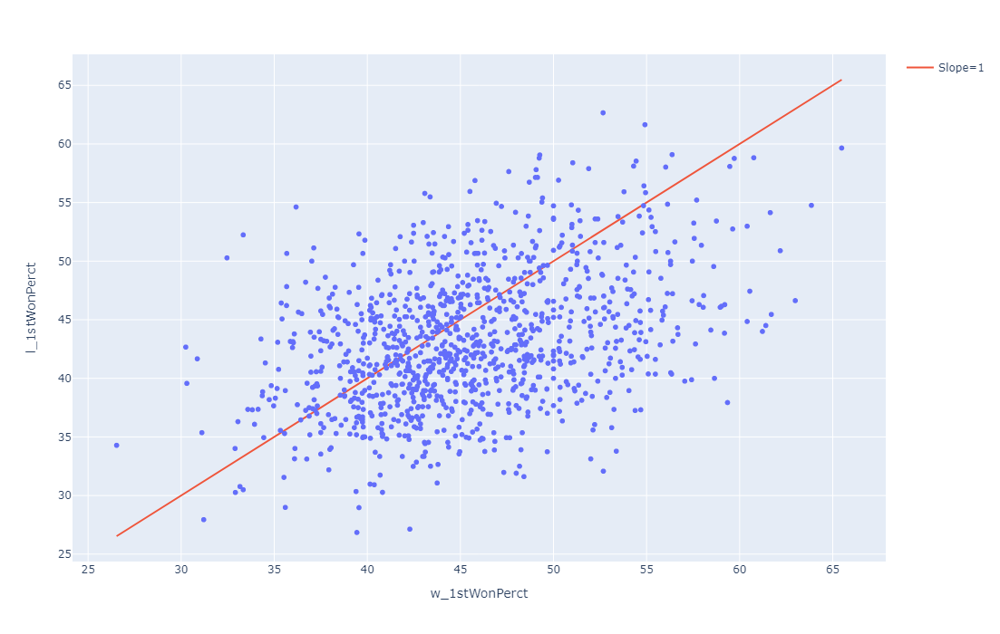

In [197]:
import plotly.graph_objects as go
fig=px.scatter(five_set2,x='w_1stWonPerct',y='l_1stWonPerct')
fig.update_layout(autosize=False,width=700,height=700)
fig.add_trace(go.Scatter(x=five_set2['w_1stWonPerct'], y=five_set2['w_1stWonPerct'],name='Slope=1',line_shape='linear'))
fig.show()
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

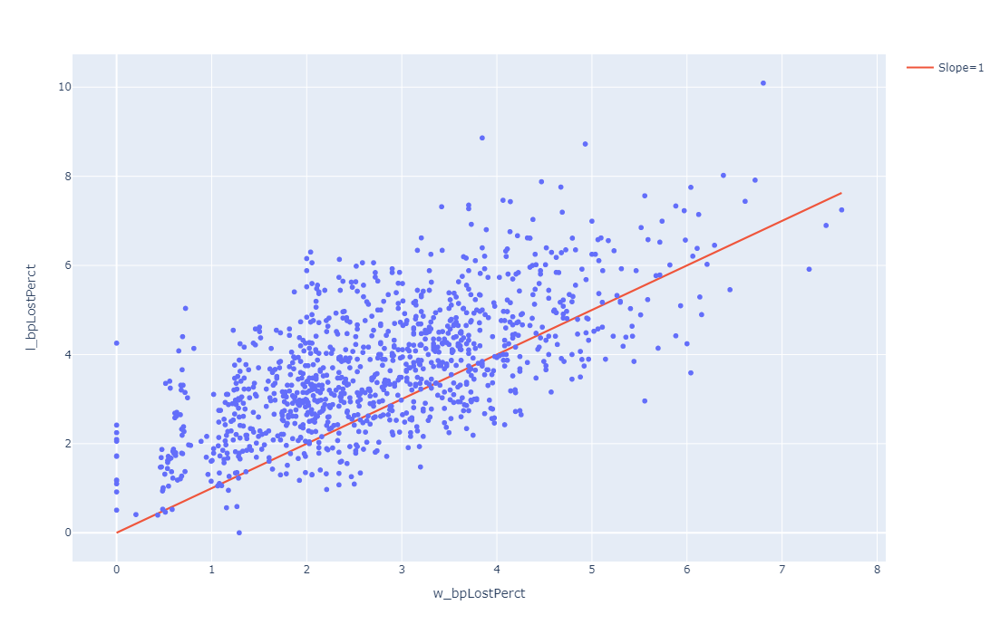

In [198]:

fig=px.scatter(five_set2,x='w_bpLostPerct',y='l_bpLostPerct')
fig.update_layout(autosize=False,width=700,height=700)
fig.add_trace(go.Scatter(x=five_set2['w_bpLostPerct'], y=five_set2['w_bpLostPerct'],name='Slope=1',line_shape='linear'))
fig.show()
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

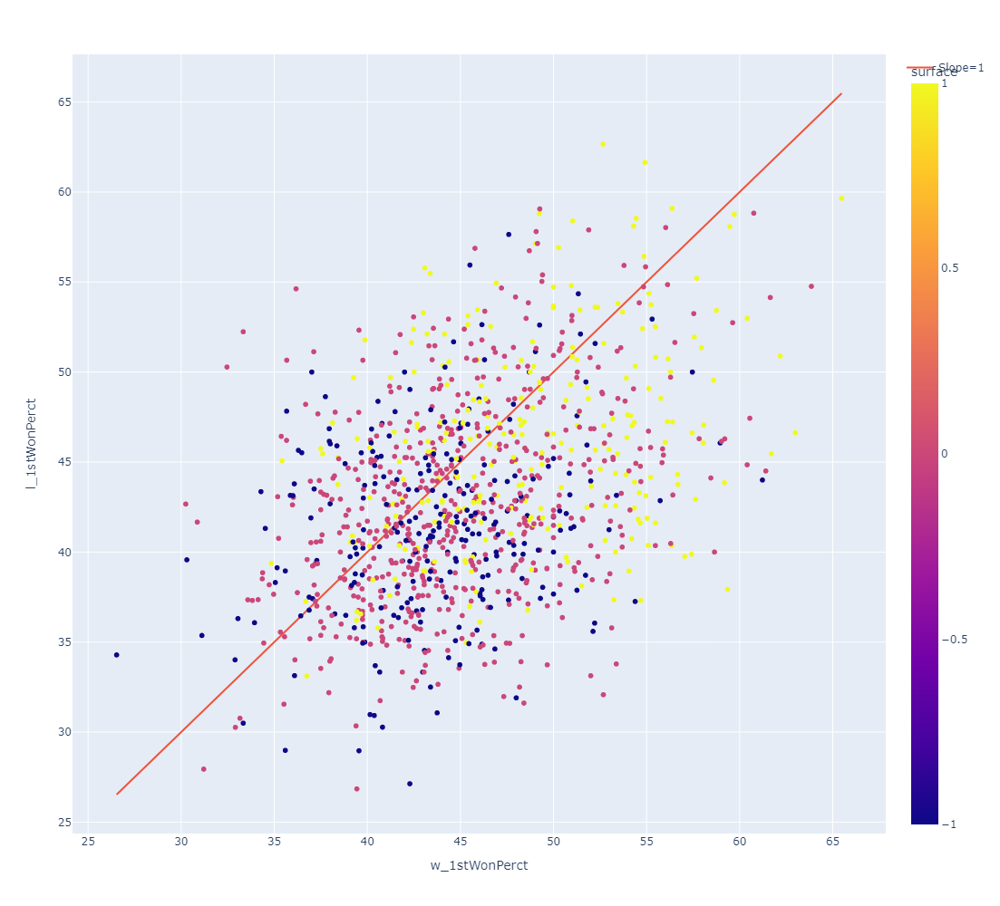

In [199]:
import plotly.graph_objects as go
fig=px.scatter(five_set2,x='w_1stWonPerct',y='l_1stWonPerct',color='surface')
fig.update_layout(autosize=False,width=1000,height=1000)
fig.add_trace(go.Scatter(x=five_set2['w_1stWonPerct'], y=five_set2['w_1stWonPerct'],name='Slope=1',line_shape='linear'))
fig.show()
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

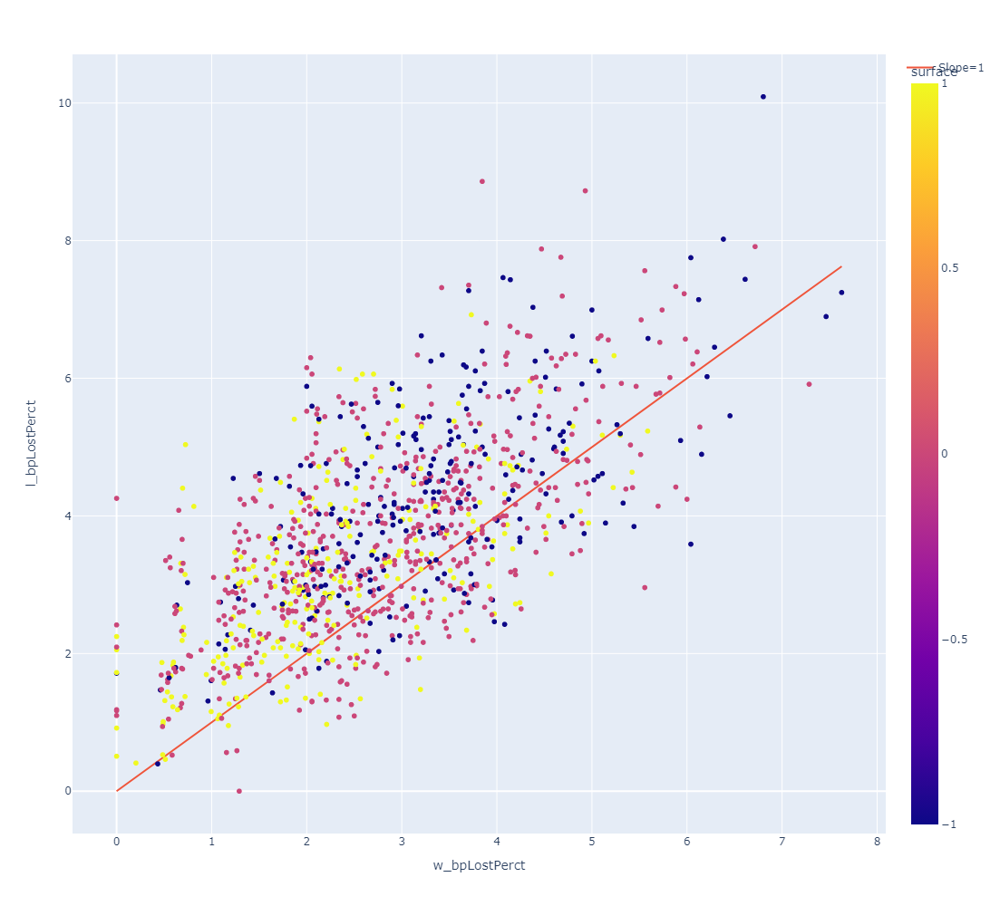

In [200]:
fig=px.scatter(five_set2,x='w_bpLostPerct',y='l_bpLostPerct',color='surface')
fig.update_layout(autosize=False,width=1000,height=1000)
fig.add_trace(go.Scatter(x=five_set2['w_bpLostPerct'], y=five_set2['w_bpLostPerct'],name='Slope=1',line_shape='linear'))
fig.show()

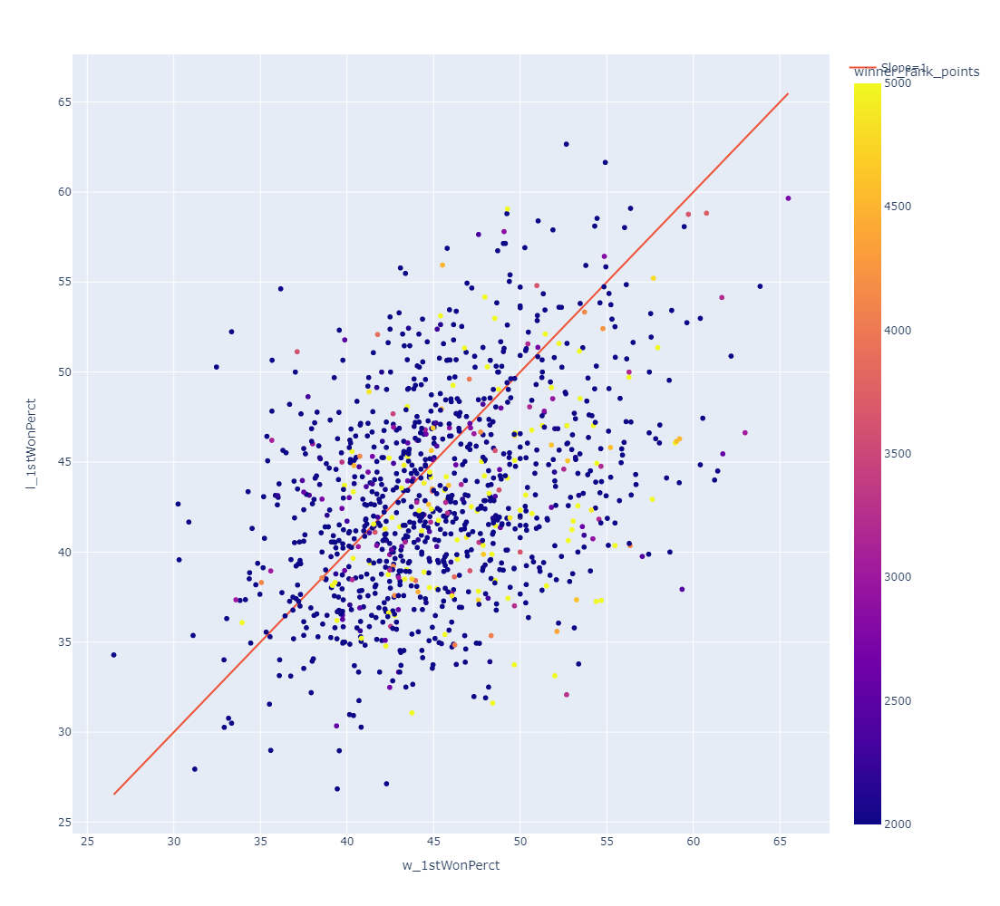

In [201]:
import plotly.graph_objects as go
fig=px.scatter(five_set2,x='w_1stWonPerct',y='l_1stWonPerct',color='winner_rank_points',range_color=(2000,5000))
fig.update_layout(autosize=False,width=1000,height=1000)
fig.add_trace(go.Scatter(x=five_set2['w_1stWonPerct'], y=five_set2['w_1stWonPerct'],name='Slope=1',line_shape='linear'))
fig.show()
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

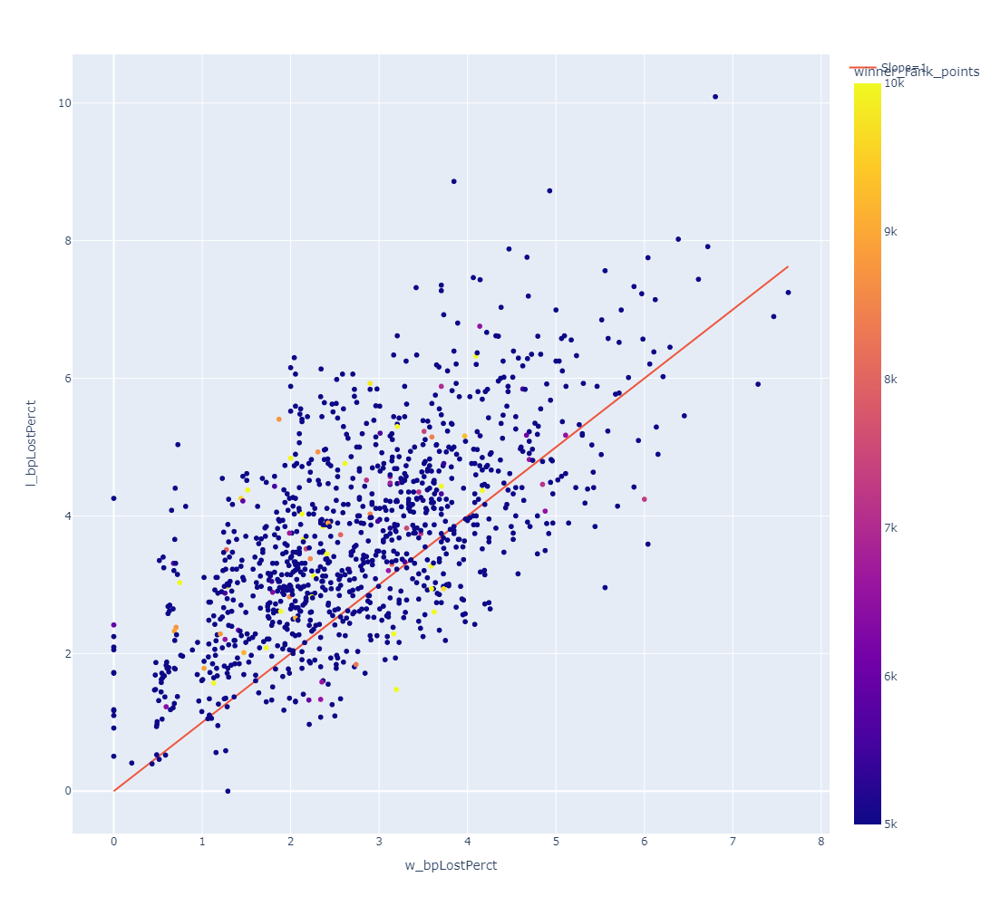

In [202]:
fig=px.scatter(five_set2,x='w_bpLostPerct',y='l_bpLostPerct',color='winner_rank_points',range_color=(5000,10000))
fig.update_layout(autosize=False,width=1000,height=1000)
fig.add_trace(go.Scatter(x=five_set2['w_bpLostPerct'], y=five_set2['w_bpLostPerct'],name='Slope=1',line_shape='linear'))
fig.show()